# Analysis for SSFA project: Two factor model

## Table of contents
1. [Used packages](#imports)
1. [Global settings](#settings)
1. [Load data](#load)
1. [Model specification](#model)
1. [Inference](#inference)
   1. [epLsar](#epLsar)
   1. [R²](#r)
   1. [Asfc](#Asfc)
   1. [Smfc](#Smfc)
   1. [HAsfc9](#HAsfc9)
   1. [HAsfc81](#HAsfc81)       

## Used packages <a name="imports"></a>

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()
import pickle
import arviz as az
import pymc3 as pm

WARNING (theano.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


In [2]:
from matplotlib.colors import to_rgb

In [3]:
import scipy.stats as stats 

In [4]:
from IPython.display import display

In [5]:
import matplotlib as mpl

In [6]:
%load_ext autoreload
%autoreload 2

In [7]:
import plotting_lib

## Global settings <a name="settings"></a>

#### Output

In [8]:
writeOut = True
outPathPlots = "../plots/statistical_model_two_factors/"
outPathData = "../derived_data/statistical_model_two_factors/"

#### Plotting

In [9]:
widthMM = 190 
widthInch = widthMM / 25.4
ratio = 0.66666
heigthInch = ratio*widthInch

SMALL_SIZE = 8
MEDIUM_SIZE = 10
BIGGER_SIZE = 12

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
sns.set_style("ticks")

dpi = 300

In [10]:
sizes = [SMALL_SIZE,MEDIUM_SIZE,BIGGER_SIZE]

#### Computing

In [11]:
numSamples = 500
numCores = 10
numTune = 1000
numPredSamples = 2000
random_seed=3651435

## Load data <a name="load"></a>

In [12]:
datafile = "../derived_data/preprocessing/preprocessed.dat"

In [13]:
with open(datafile, "rb") as f:
    x1,x2,_,df,dataZ,dictMeanStd,dictTreatment,dictSoftware = pickle.load(f)    

Show that everything is correct:

In [14]:
display(pd.DataFrame.from_dict({'x1':x1,'x2':x2}))

,x1,x2
0,0,5
1,1,5
2,0,5
3,1,5
4,0,5
...,...,...
275,1,9
276,0,9
277,1,9
278,0,9


x1 indicates the software used, x2 indicates the treatment applied.

In [15]:
for surfaceParam,(mean,std) in dictMeanStd.items():
    print("Surface parameter {} has mean {} and standard deviation {}".format(surfaceParam,mean,std))

Surface parameter epLsar has mean 0.0028221512571428575 and standard deviation 0.0019000504797019124
Surface parameter R² has mean 0.998765273042857 and standard deviation 0.0015328558023807836
Surface parameter Asfc has mean 18.13129049385357 and standard deviation 16.348381888991312
Surface parameter Smfc has mean 4.938492967075 and standard deviation 38.106353908569346
Surface parameter HAsfc9 has mean 0.3085220006979256 and standard deviation 0.2211140516395699
Surface parameter HAsfc81 has mean 0.5639598041398011 and standard deviation 0.40668126467296095


In [16]:
for k,v in dictTreatment.items():
    print("Number {} encodes treatment {}".format(k,v))

Number 5 encodes treatment Dry Bamboo
Number 6 encodes treatment Dry Grass
Number 7 encodes treatment Dry Lucerne
Number 0 encodes treatment BrushDirt
Number 1 encodes treatment BrushNoDirt
Number 4 encodes treatment Control
Number 10 encodes treatment RubDirt
Number 2 encodes treatment Clover
Number 3 encodes treatment Clover+Dust
Number 8 encodes treatment Grass
Number 9 encodes treatment Grass+Dust


In [17]:
for k,v in dictSoftware.items():
    print("Number {} encodes software {}".format(k,v))

Number 0 encodes software ConfoMap
Number 1 encodes software Toothfrax


In [18]:
display(dataZ)

,index,TreatmentNumber,SoftwareNumber,DatasetNumber,NameNumber,epLsar_z,R²_z,Asfc_z,Smfc_z,HAsfc9_z,HAsfc81_z
0,0,5,0,0,116,0.839414,-0.017104,-0.448128,-0.120476,-0.806963,-0.512247
1,1,5,1,0,116,0.999368,0.518462,-0.477757,-0.126469,-0.782634,-0.497016
2,2,5,0,0,117,1.601888,-0.509024,-0.276513,-0.119325,-0.584158,-0.662886
3,3,5,1,0,117,1.596720,0.457791,-0.301685,-0.126469,-0.629947,-0.744422
4,4,5,0,0,118,1.168099,-0.221668,-0.393502,-0.121498,-0.269712,-0.370958
...,...,...,...,...,...,...,...,...,...,...,...
275,275,9,1,2,51,0.843056,0.387986,-0.997743,-0.092631,2.388080,1.346868
276,276,9,0,2,52,0.305544,-0.791837,-0.967607,-0.104937,2.014963,2.573677
277,277,9,1,2,52,0.166758,0.635237,-0.940337,-0.126098,2.926894,3.117333
278,278,9,0,2,53,-0.843412,0.042974,-1.022523,-0.085082,0.280534,0.543577


In [19]:
display(df)

,Dataset,Name,Software,Diet,Treatment,Before.after,epLsar,R²,Asfc,Smfc,HAsfc9,HAsfc81,NewEplsar,TreatmentNumber,SoftwareNumber,DatasetNumber,NameNumber
0,GuineaPigs,capor_2CC6B1_txP4_#1_1_100xL_1,ConfoMap,Dry Bamboo,Dry Bamboo,NaN,0.004417,0.998739,10.805118,0.347586,0.130091,0.355639,0.019460,5,0,0,116
1,GuineaPigs,capor_2CC6B1_txP4_#1_1_100xL_1,Toothfrax,Dry Bamboo,Dry Bamboo,NaN,0.004721,0.999560,10.320730,0.119219,0.135471,0.361833,NaN,5,1,0,116
2,GuineaPigs,capor_2CC6B1_txP4_#1_1_100xL_2,ConfoMap,Dry Bamboo,Dry Bamboo,NaN,0.005866,0.997985,13.610750,0.391436,0.179356,0.294377,0.020079,5,0,0,117
3,GuineaPigs,capor_2CC6B1_txP4_#1_1_100xL_2,Toothfrax,Dry Bamboo,Dry Bamboo,NaN,0.005856,0.999467,13.199232,0.119219,0.169232,0.261217,NaN,5,1,0,117
4,GuineaPigs,capor_2CC6B1_txP4_#1_1_100xL_3,ConfoMap,Dry Bamboo,Dry Bamboo,NaN,0.005042,0.998425,11.698166,0.308648,0.248885,0.413098,0.019722,5,0,0,118
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
275,Sheeps,L8-Ovis-90730-lm2sin-a,Toothfrax,Grass+Dust,Grass+Dust,NaN,0.004424,0.999360,1.819802,1.408678,0.836560,1.111706,NaN,9,1,2,51
276,Sheeps,L8-Ovis-90764-lm2sin-a,ConfoMap,Grass+Dust,Grass+Dust,NaN,0.003403,0.997552,2.312486,0.939718,0.754059,1.610626,0.018978,9,0,2,52
277,Sheeps,L8-Ovis-90764-lm2sin-a,Toothfrax,Grass+Dust,Grass+Dust,NaN,0.003139,0.999739,2.758297,0.133366,0.955699,1.831721,NaN,9,1,2,52
278,Sheeps,L8-Ovis-90814-lm2sin-a,ConfoMap,Grass+Dust,Grass+Dust,NaN,0.001220,0.998831,1.414701,1.696316,0.370552,0.785022,0.017498,9,0,2,53


## Model specification <a name="model"></a>

In [20]:
class TwoFactorModel(pm.Model):
    
    """
    Compute params of priors and hyperpriors.
    """
    def getParams(self,x1,x2,y):
        # get lengths
        Nx1Lvl = np.unique(x1).size
        Nx2Lvl = np.unique(x2).size
                        
        dims = (Nx1Lvl, Nx2Lvl)
        
        ### get standard deviations
        
        # convert to pandas dataframe to use their logic
        df = pd.DataFrame.from_dict({'x1':x1,'x2':x2,'y':y})
        
        s1 = df.groupby('x1').std()['y'].max()
        s2 = df.groupby('x2').std()['y'].max()
                
        stdSingle = (s1, s2)
        
        prefac = 0.05
        s12 = prefac * np.linalg.norm([s1,s2])
        
        stdMulti = (s12)
        
        return (dims, stdSingle, stdMulti)
    
    def printParams(self,x1,x2,y):
        dims, stdSingle, stdMulti = self.getParams(x1,x2,y)
        Nx1Lvl, Nx2Lvl = dims
        s1, s2 = stdSingle
        s12 = stdMulti
        
        print("The number of levels of the x variables are {}".format(dims))
        print("The standard deviations used for the beta priors are  {}".format(stdSingle))
        print("The standard deviations used for the M12 priors are {}".format(stdMulti))
    
    def __init__(self,name,x1,x2,y,model=None):
        
        # call super's init first, passing model and name
        super().__init__(name, model)
        
        # get parameter of hyperpriors
        dims, stdSingle, stdMulti = self.getParams(x1,x2,y)
        Nx1Lvl, Nx2Lvl = dims
        s1, s2 = stdSingle
        s12 = stdMulti
        
        ### hyperpriors ### 
        # observation hyperpriors
        lamY = 1/30.
        muGamma = 0.5
        sigmaGamma = 2.
        
        # prediction hyperpriors
        sigma0 = pm.HalfNormal('sigma0',sd=1)
        sigma1 = pm.HalfNormal('sigma1',sd=s1, shape=Nx1Lvl)       
        sigma2 = pm.HalfNormal('sigma2',sd=s2, shape=Nx2Lvl)
        beta2 = (np.sqrt(6)*sigma2)/(np.pi)
        
        mu_b0 = pm.Normal('mu_b0', mu=0., sd=1)
        mu_b1 = pm.Normal('mu_b1', mu=0., sd=1, shape=Nx1Lvl)        
        mu_b2 = pm.Normal('mu_b2', mu=0., sd=1, shape=Nx2Lvl)       
        
        sigma12 = pm.HalfNormal('sigma12',sd=s12)
                               
        ### priors ### 
        # observation priors        
        nuY = pm.Exponential('nuY',lam=lamY)
        sigmaY = pm.Gamma('sigmaY',mu=muGamma, sigma=sigmaGamma)
        
        # prediction priors
        b0_dist = pm.Normal('b0_dist', mu=0, sd=1)
        b0 = pm.Deterministic("b0", mu_b0 + b0_dist * sigma0)
       
        b1_dist = pm.Normal('b1_dist', mu=0, sd=1)
        b1 = pm.Deterministic("b1", mu_b1 + b1_dist * sigma1)
                        
        b2_beta = pm.HalfNormal('b2_beta', sd=beta2, shape=Nx2Lvl)
        b2_dist = pm.Gumbel('b2_dist', mu=0, beta=1)
        b2 = pm.Deterministic("b2", mu_b2 + b2_beta * b2_dist)
        
        mu_M12 = pm.Normal('mu_M12', mu=0., sd=1, shape=[Nx1Lvl, Nx2Lvl])
        M12_dist = pm.Normal('M12_dist', mu=0, sd=1)
        M12 = pm.Deterministic("M12", mu_M12 + M12_dist * sigma12)
        
        #### prediction ###         
        mu = pm.Deterministic('mu',b0 + b1[x1]+ b2[x2] +  M12[x1,x2] )
                                        
        ### observation ### 
        y = pm.StudentT('y',nu = nuY, mu=mu, sd=sigmaY, observed=y)

## Inference <a name="inference"></a>

### epLsar <a name="epLsar"></a>

In [21]:
with pm.Model() as model:
    epLsarModel = TwoFactorModel('epLsar',x1,x2,dataZ.epLsar_z.values)

#### Verify model settings

In [22]:
epLsarModel.printParams(x1,x2,dataZ.epLsar_z.values)

The number of levels of the x variables are (2, 11)
The standard deviations used for the beta priors are  (1.0034852973454325, 1.2901096312620055)
The standard deviations used for the M12 priors are 0.08172156390242785


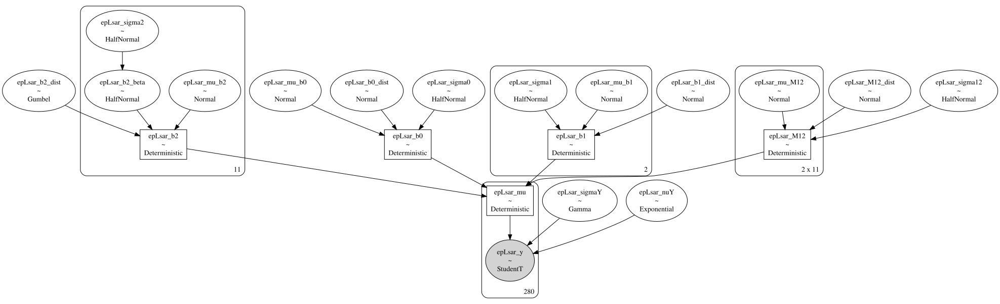

In [23]:
try:
    graph_epLsar = pm.model_to_graphviz(epLsarModel)    
except:
    graph_epLsar = "Could not make graph"
graph_epLsar

#### Check prior choice

In [24]:
with epLsarModel as model:
    prior_pred_epLsar = pm.sample_prior_predictive(samples=numPredSamples,random_seed=random_seed)

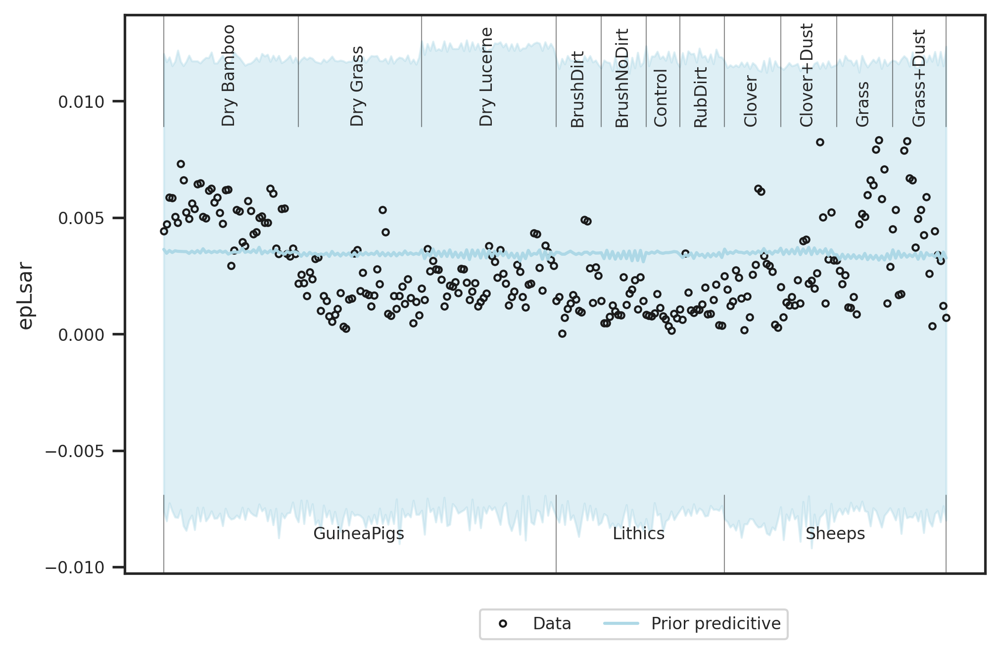

In [25]:
plotting_lib.plotPriorPredictive(widthInch,heigthInch,dpi,writeOut,outPathPlots,df,dictMeanStd,prior_pred_epLsar,dataZ.epLsar_z.values,'epLsar')

Prior choice is as intended: Broad over the data range.

#### Sampling

In [26]:
with epLsarModel as model:
    trace_epLsar = pm.sample(numSamples,cores=numCores,tune=numTune,max_treedepth=20, init='auto',target_accept=0.95,random_seed=random_seed)
    #fit_epLsar = pm.fit(random_seed=random_seed)
    #trace_epLsar = fit_epLsar.sample(draws=numSamples)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (10 chains in 10 jobs)
NUTS: [epLsar_M12_dist, epLsar_mu_M12, epLsar_b2_dist, epLsar_b2_beta, epLsar_b1_dist, epLsar_b0_dist, epLsar_sigmaY, epLsar_nuY, epLsar_sigma12, epLsar_mu_b2, epLsar_mu_b1, epLsar_mu_b0, epLsar_sigma2, epLsar_sigma1, epLsar_sigma0]


Sampling 10 chains for 1_000 tune and 500 draw iterations (10_000 + 5_000 draws total) took 193 seconds.


In [27]:
with epLsarModel as model:
    if writeOut:
        with open(outPathData + 'model_{}.pkl'.format('epLsar'), 'wb') as buff:
            pickle.dump({'model':epLsarModel, 'trace': trace_epLsar}, buff)            

##### Save for later comparison

In [28]:
if writeOut:
    np.save('../derived_data/statistical_model_two_factors/epLsar_oldb1', trace_epLsar['epLsar_b1'])
    np.save('../derived_data/statistical_model_two_factors/epLsar_oldb2', trace_epLsar['epLsar_b2'])
    np.save('../derived_data/statistical_model_two_factors/epLsar_oldM12', trace_epLsar['epLsar_M12'])

#### Check sampling

In [29]:
with epLsarModel as model:
    dataTrace_epLsar = az.from_pymc3(trace=trace_epLsar)

In [30]:
pm.summary(dataTrace_epLsar,hdi_prob=0.95).round(2)

,mean,sd,hdi_2.5%,hdi_97.5%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
epLsar_mu_b0,-0.09,0.79,-1.70,1.44,0.01,0.01,5425.0,2884.0,5427.0,3762.0,1.0
epLsar_mu_b1[0],-0.03,0.70,-1.39,1.39,0.01,0.01,4860.0,2747.0,4867.0,3934.0,1.0
epLsar_mu_b1[1],-0.07,0.71,-1.53,1.25,0.01,0.01,5257.0,2785.0,5261.0,3982.0,1.0
epLsar_mu_b2[0],-0.25,0.68,-1.59,1.06,0.01,0.01,4407.0,3292.0,4401.0,4000.0,1.0
epLsar_mu_b2[1],-0.36,0.67,-1.70,0.93,0.01,0.01,4184.0,3665.0,4184.0,3778.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...
epLsar_mu[275],0.68,0.27,0.15,1.19,0.00,0.00,5046.0,4965.0,5046.0,4460.0,1.0
epLsar_mu[276],0.72,0.31,0.12,1.32,0.00,0.00,4876.0,4562.0,4894.0,3579.0,1.0
epLsar_mu[277],0.68,0.27,0.15,1.19,0.00,0.00,5046.0,4965.0,5046.0,4460.0,1.0
epLsar_mu[278],0.72,0.31,0.12,1.32,0.00,0.00,4876.0,4562.0,4894.0,3579.0,1.0


/home/bob/.local/lib/python3.8/site-packages/arviz/plots/backends/matplotlib/pairplot.py:212: UserWarning: rcParams['plot.max_subplots'] (40) is smaller than the number of resulting pair plots with these variables, generating only a 8x8 grid
  warnings.warn(


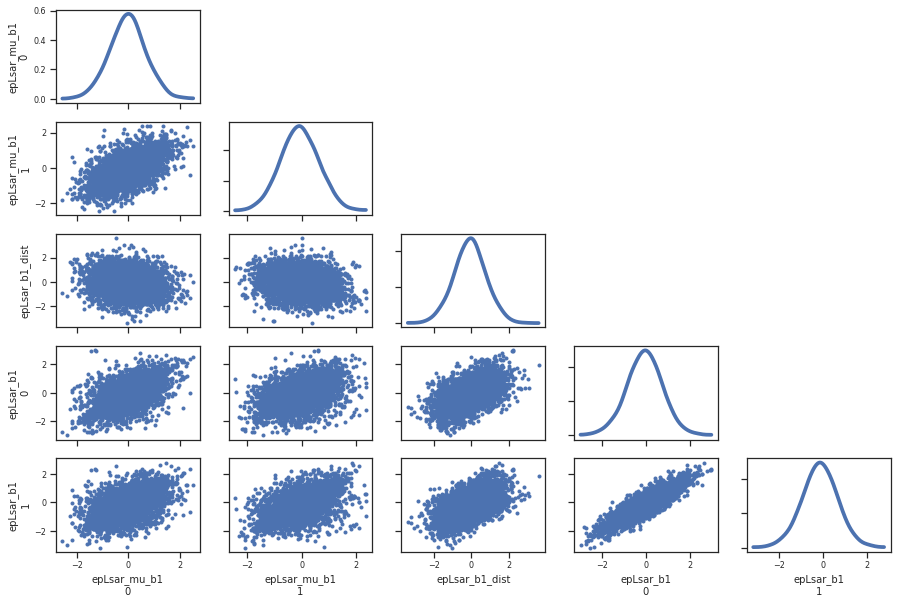

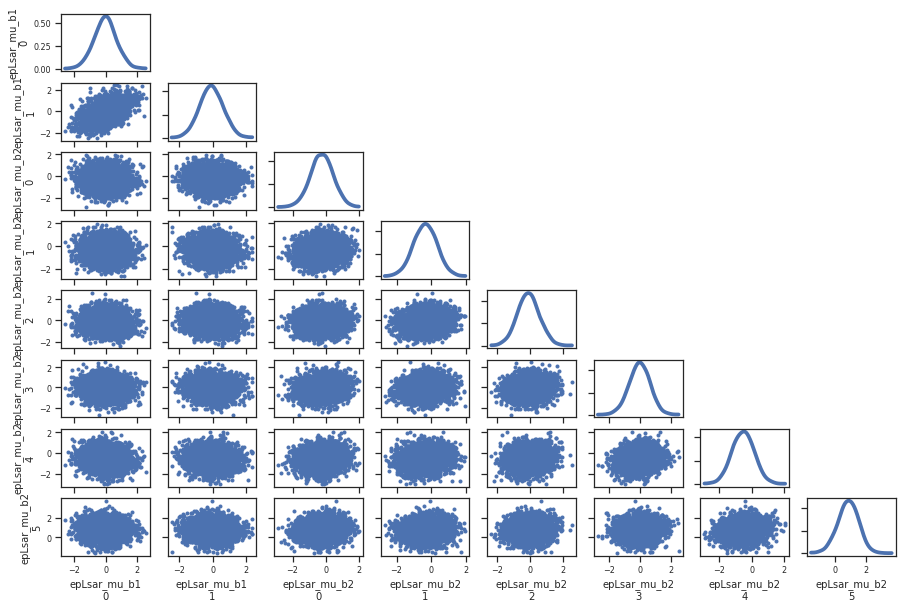

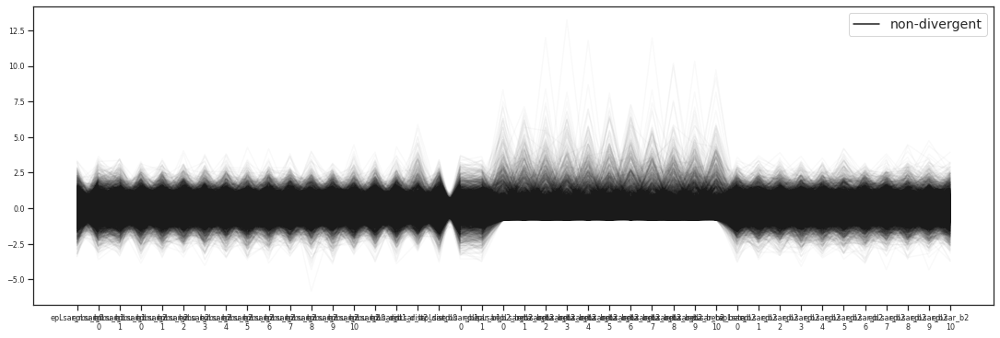

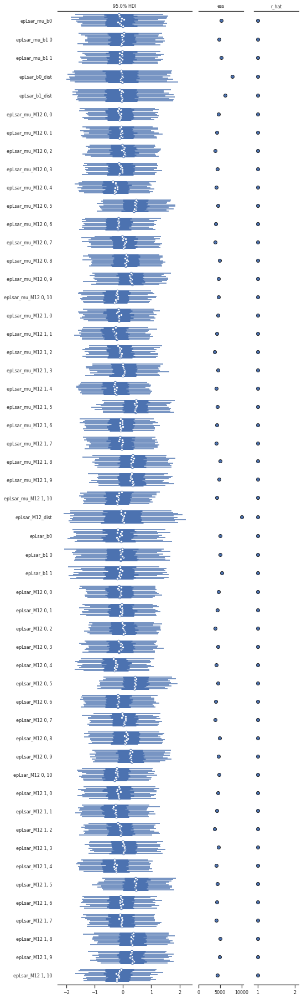

In [31]:
plotting_lib.plotDiagnostics(widthInch,heigthInch,dpi,writeOut,outPathPlots,trace_epLsar,dataTrace_epLsar,'epLsar')

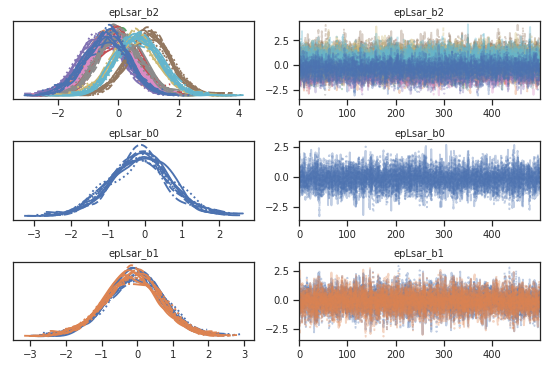

In [32]:
with epLsarModel as model:
    plotting_lib.plotTracesB(widthInch,heigthInch,dpi,writeOut,outPathPlots,trace_epLsar,'epLsar')

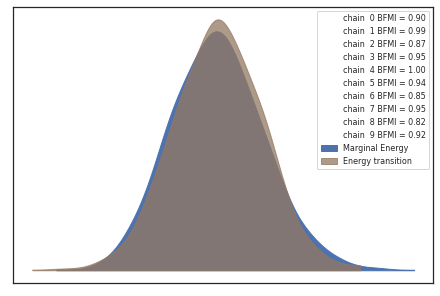

In [33]:
with epLsarModel as model:
    plotting_lib.pm.energyplot(trace_epLsar)

#### Posterior predictive distribution

In [34]:
with epLsarModel as model:
    posterior_pred_epLsar = pm.sample_posterior_predictive(trace_epLsar,samples=numPredSamples,random_seed=random_seed)

/home/bob/.local/lib/python3.8/site-packages/pymc3/sampling.py:1707: UserWarning: samples parameter is smaller than nchains times ndraws, some draws and/or chains may not be represented in the returned posterior predictive sample
  warnings.warn(


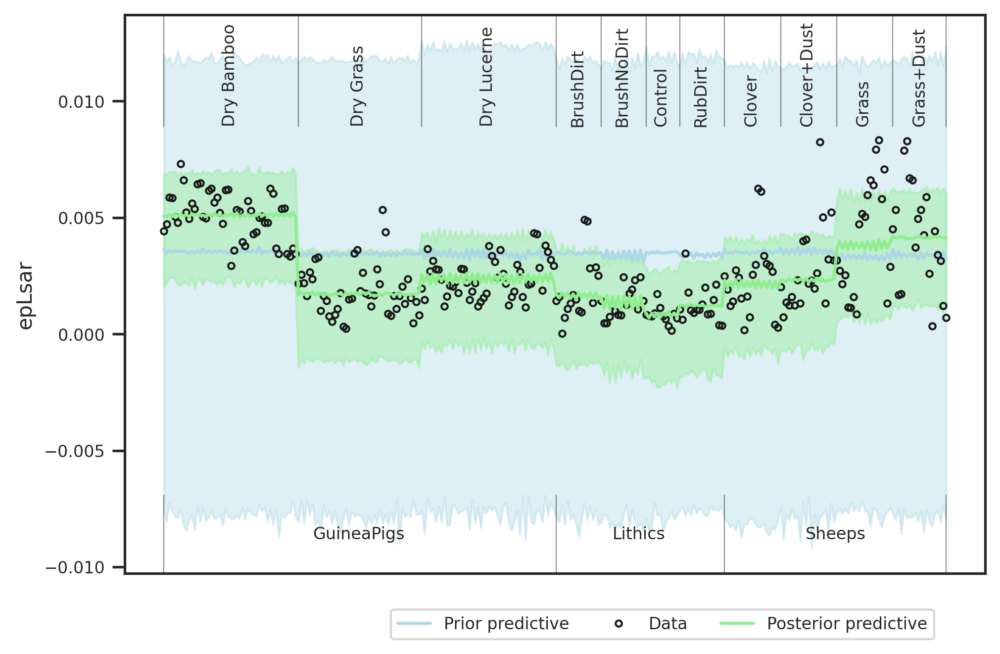

In [35]:
plotting_lib.plotPriorPosteriorPredictive(widthInch,heigthInch,dpi,writeOut,outPathPlots,df,dictMeanStd,prior_pred_epLsar,posterior_pred_epLsar,dataZ.epLsar_z.values,'epLsar')

#### Level plots

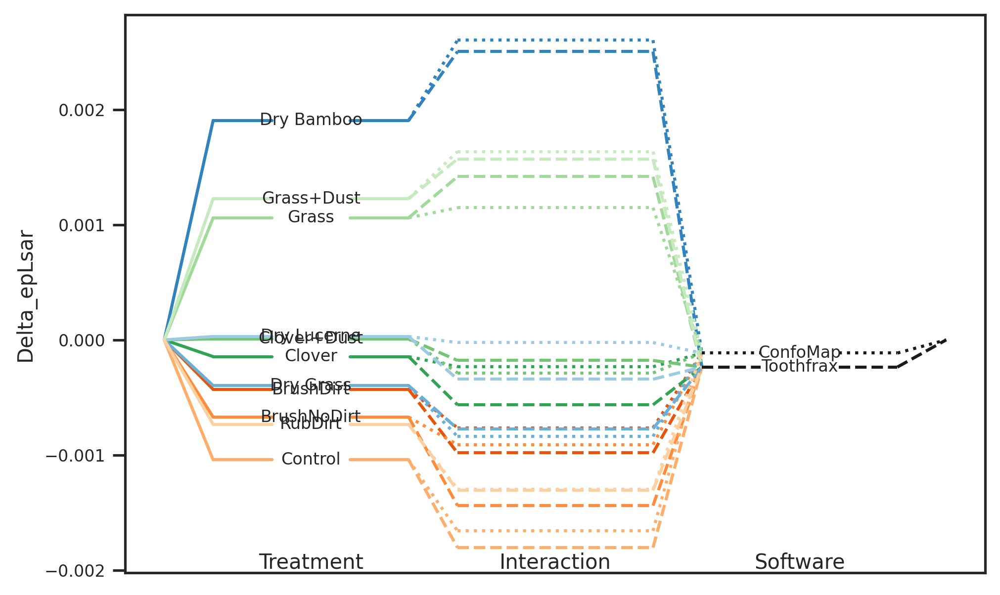

In [36]:
plotting_lib.plotLevels(widthInch,heigthInch,dpi,sizes,writeOut,outPathPlots,dictMeanStd,dictTreatment,dictSoftware,trace_epLsar,'epLsar',x1,x2)

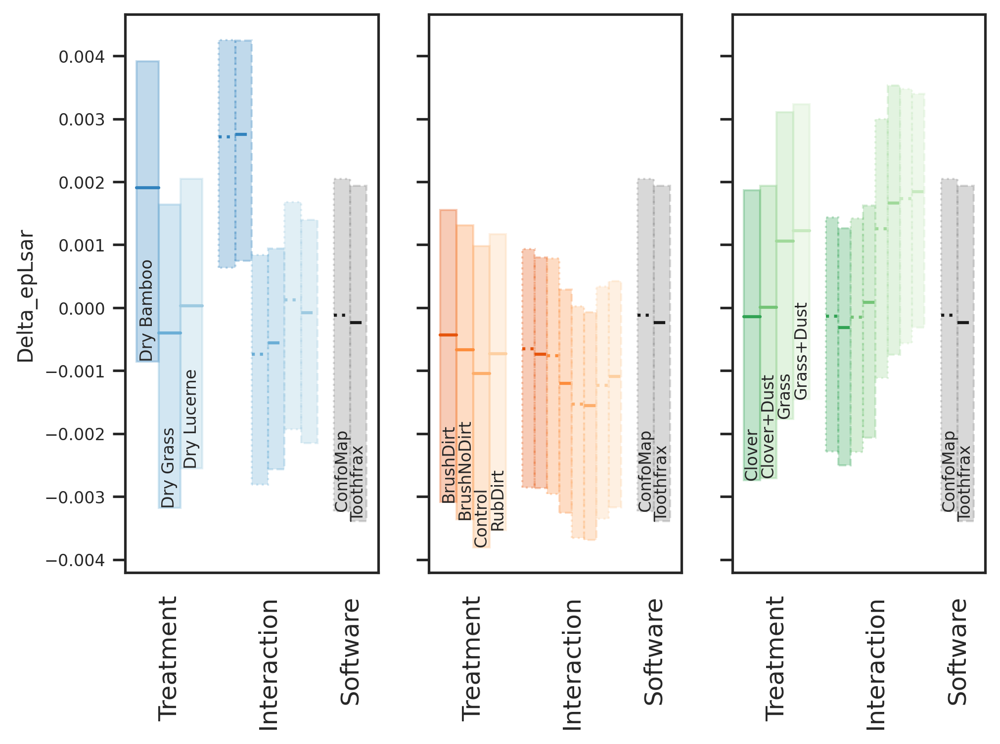

In [37]:
plotting_lib.plotLevelsStd(widthInch,heigthInch,dpi,sizes,writeOut,outPathPlots,dictMeanStd,dictTreatment,dictSoftware,trace_epLsar,'epLsar',x1,x2)

#### Posterior and contrasts

In [38]:
df_hdi_epLsar = plotting_lib.plotTreatmentPosterior(widthInch,heigthInch,dpi,sizes,writeOut,outPathPlots,dictMeanStd,dictTreatment,dictSoftware,trace_epLsar,'epLsar',x1,x2)

In [39]:
df_hdi_epLsar

,Treatment_i,Treatment_j,hdi_ConfoMap_2.5%,hdi_ConfoMap_97.5%,isSignificant_on_ConfoMap,hdi_Toothfrax_2.5%,hdi_Toothfrax_97.5%,isSignificant_on_Toothfrax
0,Dry Grass,Dry Bamboo,-0.004067,-0.002744,True,-0.003976,-0.002647,True
1,Dry Lucerne,Dry Bamboo,-0.003291,-0.001971,True,-0.003465,-0.002210,True
2,Dry Lucerne,Dry Grass,0.000215,0.001528,True,-0.000166,0.001127,False
3,BrushNoDirt,BrushDirt,-0.001322,0.001007,False,-0.001513,0.000565,False
4,Control,BrushDirt,-0.002129,0.000235,False,-0.001954,0.000213,False
5,Control,BrushNoDirt,-0.001726,0.000381,False,-0.001382,0.000666,False
6,RubDirt,BrushDirt,-0.001713,0.000537,False,-0.001373,0.000730,False
7,RubDirt,BrushNoDirt,-0.001426,0.000616,False,-0.000906,0.001069,False
8,RubDirt,Control,-0.000705,0.001380,False,-0.000561,0.001490,False
9,Clover+Dust,Clover,-0.001075,0.001140,False,-0.000765,0.001629,False


In [40]:
if writeOut:
    df_hdi_epLsar.to_csv(outPathData+ 'hdi_{}.csv'.format('epLsar'))

### R²<a name="r"></a>

In [41]:
with pm.Model() as model:
    RsquaredModel = TwoFactorModel('R²',x1,x2,dataZ["R²_z"].values)

#### Verify model settings

In [42]:
RsquaredModel.printParams(x1,x2,dataZ["R²_z"].values)

The number of levels of the x variables are (2, 11)
The standard deviations used for the beta priors are  (1.0112351887037512, 2.890846695679254)
The standard deviations used for the M12 priors are 0.1531305915288677


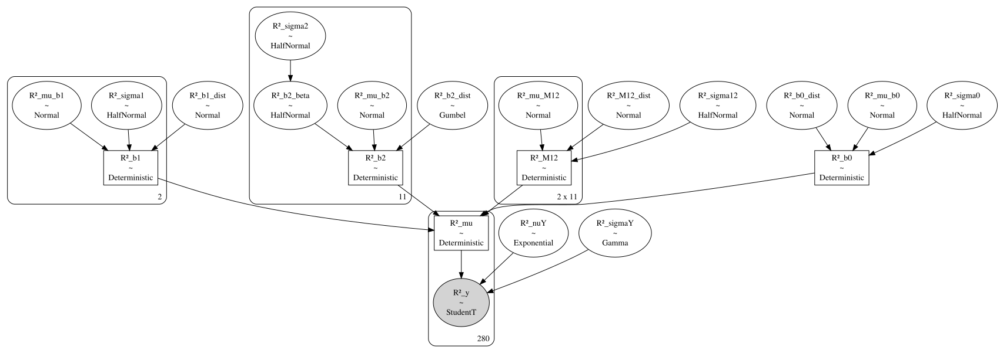

In [43]:
pm.model_to_graphviz(RsquaredModel)

#### Check prior choice

In [44]:
with RsquaredModel as model:
    prior_pred_Rsquared = pm.sample_prior_predictive(samples=numPredSamples,random_seed=random_seed)

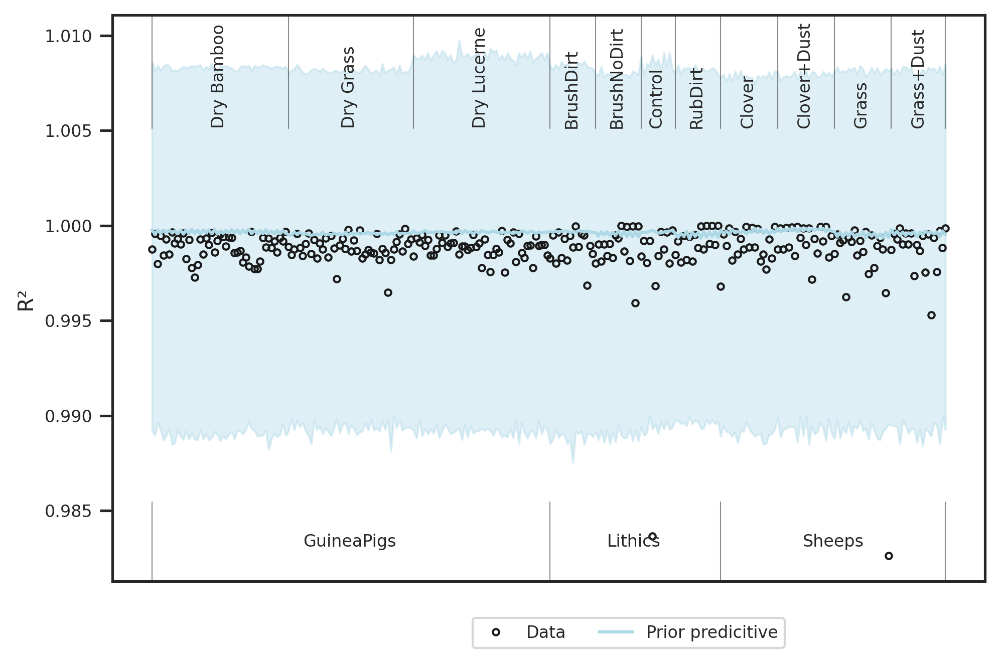

In [45]:
plotting_lib.plotPriorPredictive(widthInch,heigthInch,dpi,writeOut,outPathPlots,df,dictMeanStd,prior_pred_Rsquared,dataZ["R²_z"].values,'R²')

#### Sampling

In [46]:
with RsquaredModel as model:
    trace_Rsquared = pm.sample(numSamples,cores=numCores,tune=numTune,max_treedepth=20, init='auto',target_accept=0.99,random_seed=random_seed)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (10 chains in 10 jobs)
NUTS: [R²_M12_dist, R²_mu_M12, R²_b2_dist, R²_b2_beta, R²_b1_dist, R²_b0_dist, R²_sigmaY, R²_nuY, R²_sigma12, R²_mu_b2, R²_mu_b1, R²_mu_b0, R²_sigma2, R²_sigma1, R²_sigma0]


Sampling 10 chains for 1_000 tune and 500 draw iterations (10_000 + 5_000 draws total) took 732 seconds.


In [47]:
with RsquaredModel as model:
    if writeOut:
        with open(outPathData + 'model_{}.pkl'.format('R²'), 'wb') as buff:
            pickle.dump({'model': RsquaredModel, 'trace': trace_Rsquared}, buff)

#### Check sampling

In [48]:
with RsquaredModel as model:
    dataTrace_Rsquared = az.from_pymc3(trace=trace_Rsquared)

In [49]:
pm.summary(dataTrace_Rsquared,hdi_prob=0.95).round(2)

,mean,sd,hdi_2.5%,hdi_97.5%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
R²_mu_b0,0.06,0.81,-1.52,1.64,0.01,0.01,5502.0,2696.0,5518.0,3915.0,1.0
R²_mu_b1[0],-0.21,0.72,-1.61,1.24,0.01,0.01,4648.0,3068.0,4644.0,3840.0,1.0
R²_mu_b1[1],0.27,0.72,-1.10,1.74,0.01,0.01,5066.0,3627.0,5073.0,4140.0,1.0
R²_mu_b2[0],-0.01,0.67,-1.34,1.25,0.01,0.01,3977.0,2832.0,3960.0,3601.0,1.0
R²_mu_b2[1],-0.03,0.66,-1.30,1.25,0.01,0.01,4154.0,3450.0,4155.0,3974.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...
R²_mu[275],0.53,0.07,0.39,0.68,0.00,0.00,4891.0,4891.0,4951.0,4145.0,1.0
R²_mu[276],-0.01,0.12,-0.23,0.21,0.00,0.00,4383.0,2619.0,4827.0,4134.0,1.0
R²_mu[277],0.53,0.07,0.39,0.68,0.00,0.00,4891.0,4891.0,4951.0,4145.0,1.0
R²_mu[278],-0.01,0.12,-0.23,0.21,0.00,0.00,4383.0,2619.0,4827.0,4134.0,1.0


/home/bob/.local/lib/python3.8/site-packages/arviz/plots/backends/matplotlib/pairplot.py:212: UserWarning: rcParams['plot.max_subplots'] (40) is smaller than the number of resulting pair plots with these variables, generating only a 8x8 grid
  warnings.warn(


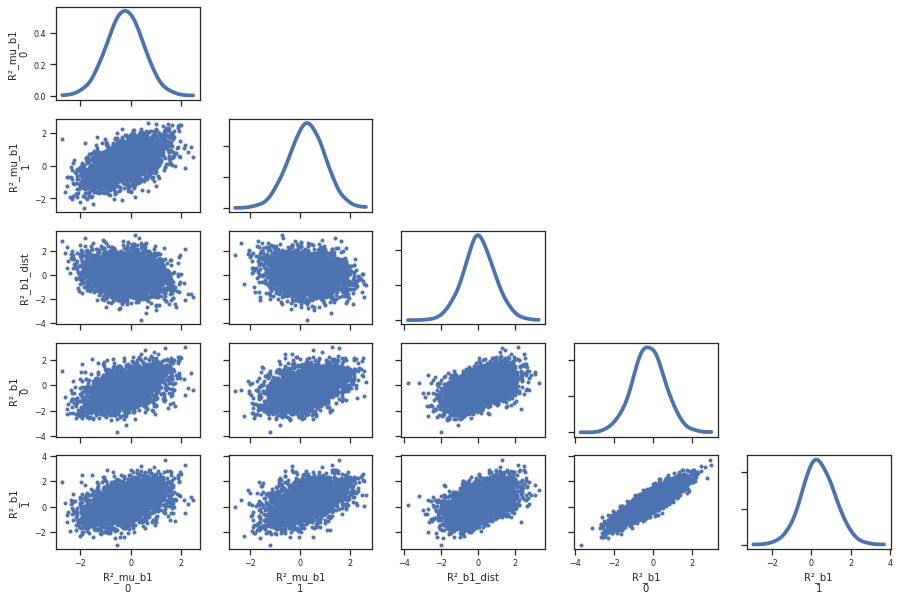

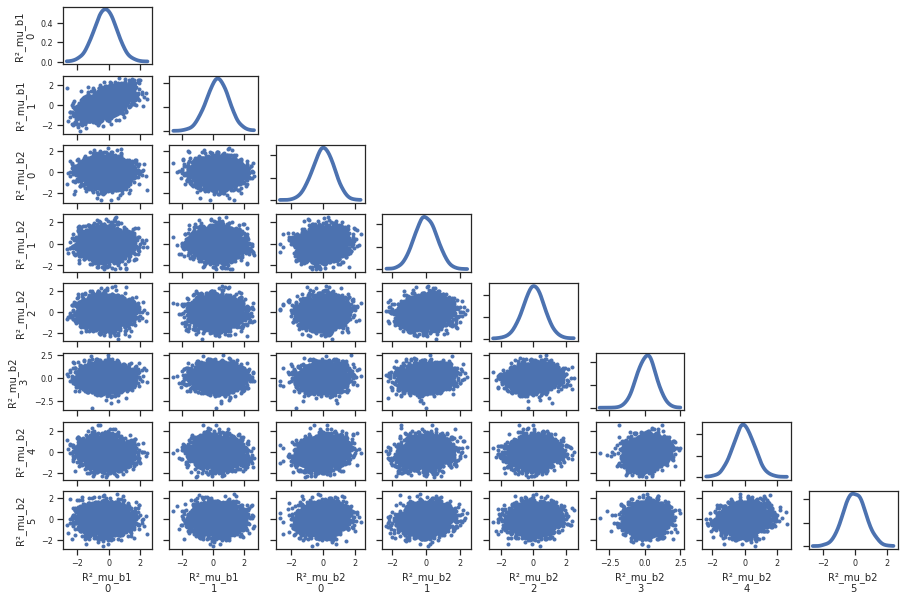

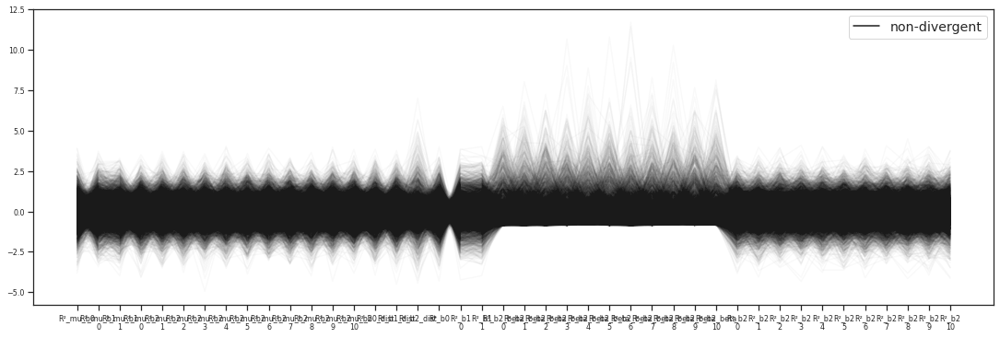

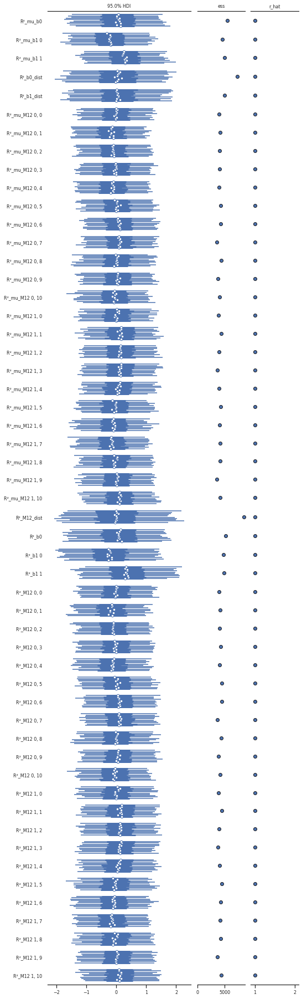

In [50]:
plotting_lib.plotDiagnostics(widthInch,heigthInch,dpi,writeOut,outPathPlots,trace_Rsquared,dataTrace_Rsquared,'R²')

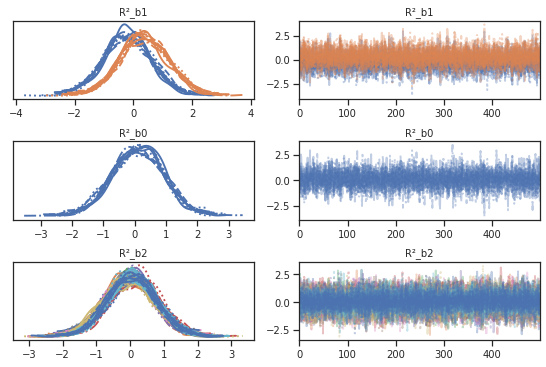

In [51]:
with RsquaredModel as model:
    plotting_lib.plotTracesB(widthInch,heigthInch,dpi,writeOut,outPathPlots,trace_Rsquared,'R²')

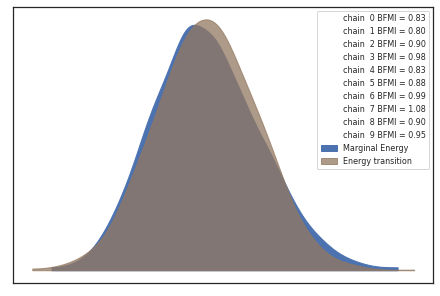

In [52]:
with RsquaredModel as model:
    plotting_lib.pm.energyplot(trace_Rsquared)

#### Posterior predictive distribution

In [53]:
with RsquaredModel as model:
    posterior_pred_Rsquared = pm.sample_posterior_predictive(trace_Rsquared,samples=numPredSamples,random_seed=random_seed)

/home/bob/.local/lib/python3.8/site-packages/pymc3/sampling.py:1707: UserWarning: samples parameter is smaller than nchains times ndraws, some draws and/or chains may not be represented in the returned posterior predictive sample
  warnings.warn(


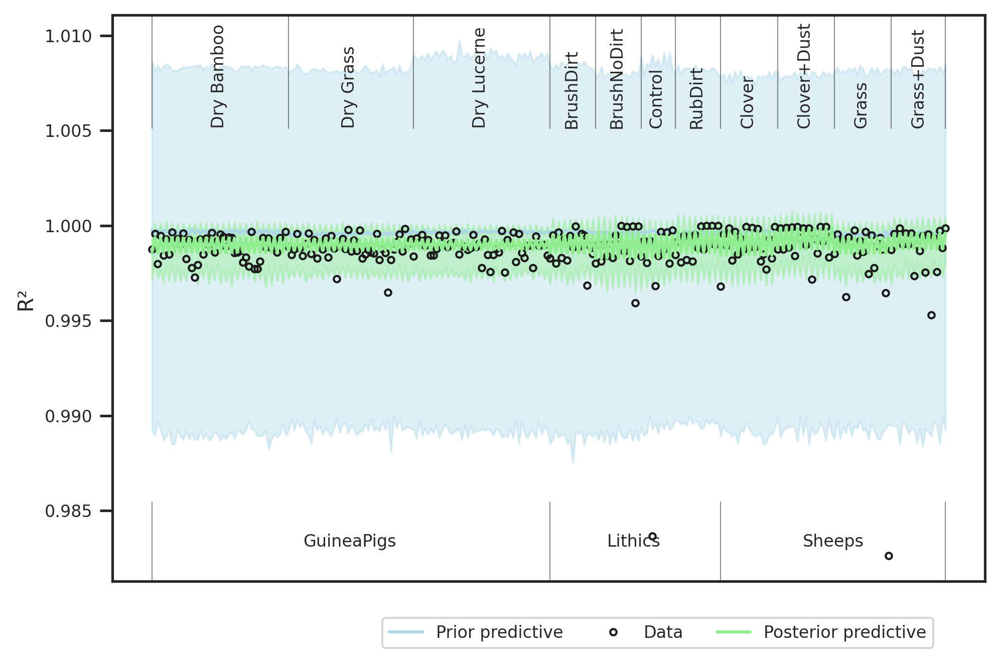

In [54]:
plotting_lib.plotPriorPosteriorPredictive(widthInch,heigthInch,dpi,writeOut,outPathPlots,df,dictMeanStd,prior_pred_Rsquared,posterior_pred_Rsquared,dataZ["R²_z"].values,'R²')

#### Compare prior and posterior for model parameters

In [55]:
with RsquaredModel as model:
    pm_data_Rsquared = az.from_pymc3(trace=trace_Rsquared,prior=prior_pred_Rsquared,posterior_predictive=posterior_pred_Rsquared)

arviz.data.io_pymc3 - WARNING - posterior predictive variable R²_y's shape not compatible with number of chains and draws. This can mean that some draws or even whole chains are not represented.


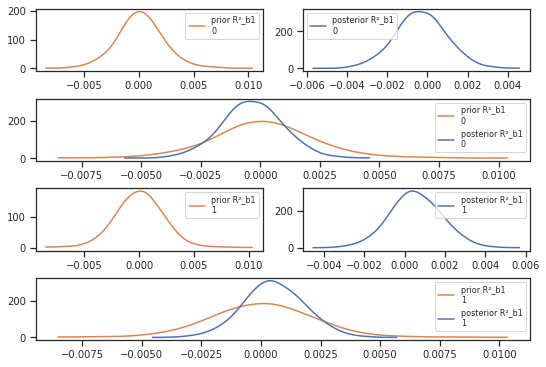

In [56]:
plotting_lib.plotPriorPosteriorB(widthInch,heigthInch,dpi,sizes,writeOut,outPathPlots,dictMeanStd,pm_data_Rsquared,'R²')

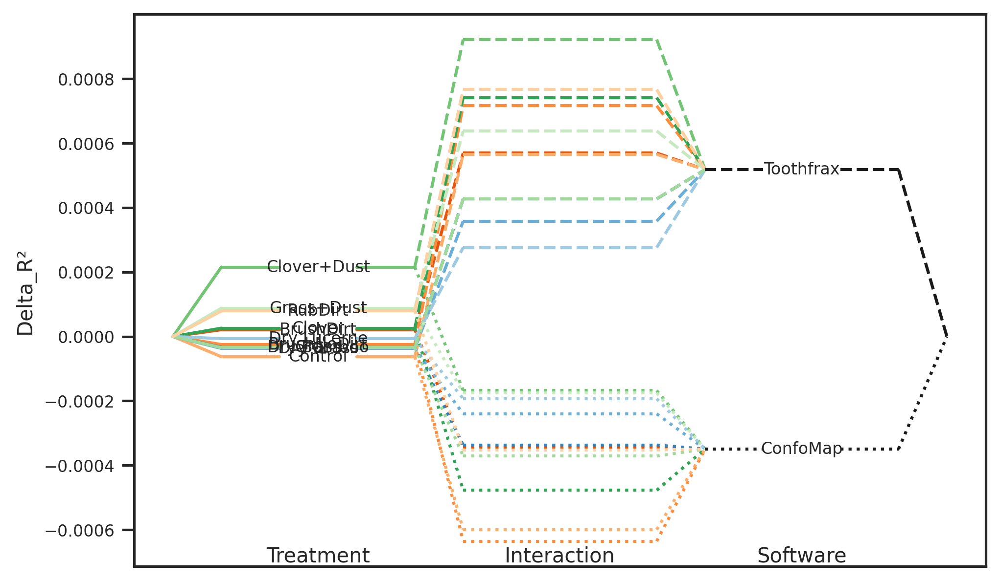

In [57]:
plotting_lib.plotLevels(widthInch,heigthInch,dpi,sizes,writeOut,outPathPlots,dictMeanStd,dictTreatment,dictSoftware,trace_Rsquared,'R²',x1,x2)

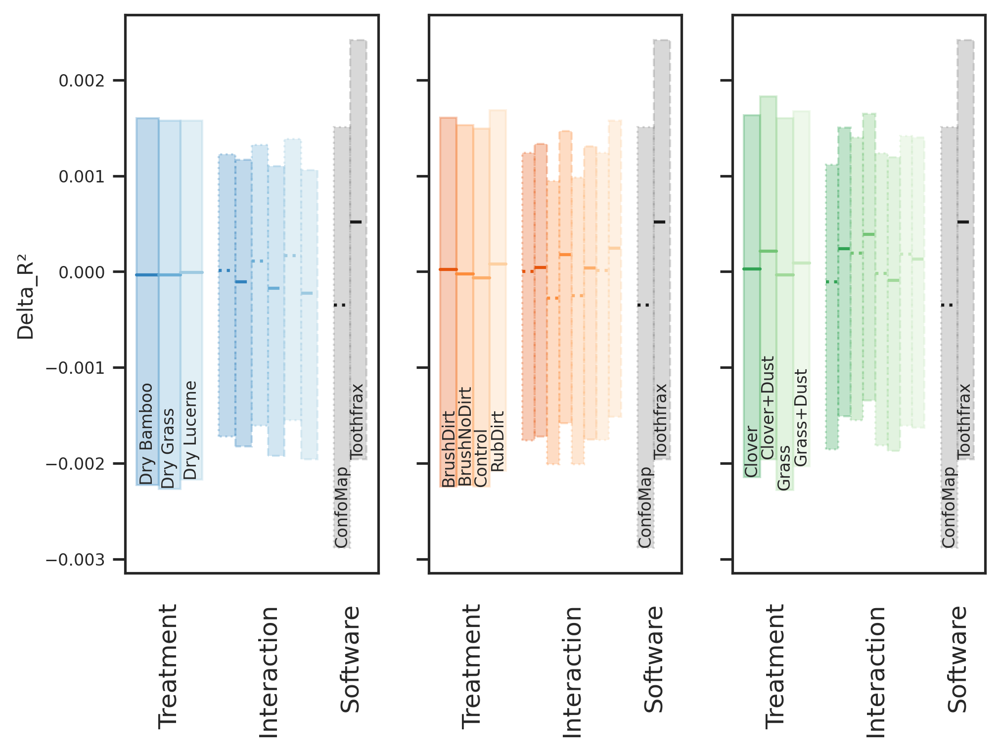

In [58]:
plotting_lib.plotLevelsStd(widthInch,heigthInch,dpi,sizes,writeOut,outPathPlots,dictMeanStd,dictTreatment,dictSoftware,trace_Rsquared,'R²',x1,x2)

#### Posterior and contrasts

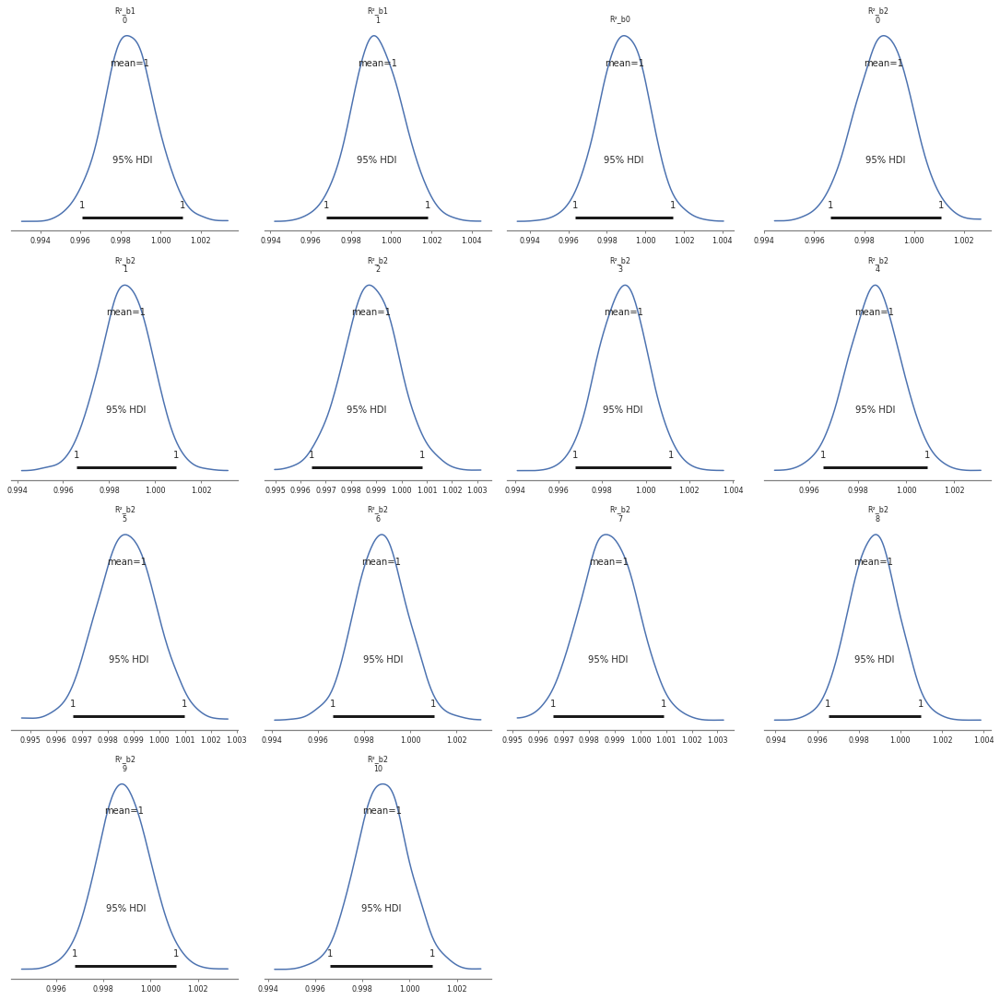

In [59]:
plotting_lib.plotPosterior(widthInch,heigthInch,dpi,writeOut,outPathPlots,dictMeanStd,pm_data_Rsquared,'R²')

In [60]:
df_hdi_R = plotting_lib.plotTreatmentPosterior(widthInch,heigthInch,dpi,sizes,writeOut,outPathPlots,dictMeanStd,dictTreatment,dictSoftware,trace_Rsquared,'R²',x1,x2)

In [61]:
df_hdi_R

,Treatment_i,Treatment_j,hdi_ConfoMap_2.5%,hdi_ConfoMap_97.5%,isSignificant_on_ConfoMap,hdi_Toothfrax_2.5%,hdi_Toothfrax_97.5%,isSignificant_on_Toothfrax
0,Dry Grass,Dry Bamboo,-0.000170,0.000357,False,-0.000320,0.000205,False
1,Dry Lucerne,Dry Bamboo,-0.000111,0.000435,False,-0.000353,0.000114,False
2,Dry Lucerne,Dry Grass,-0.000182,0.000285,False,-0.000338,0.000222,False
3,BrushNoDirt,BrushDirt,-0.000799,0.000192,False,-0.000403,0.000604,False
4,Control,BrushDirt,-0.000806,0.000270,False,-0.000464,0.000426,False
5,Control,BrushNoDirt,-0.000439,0.000502,False,-0.000690,0.000398,False
6,RubDirt,BrushDirt,-0.000495,0.000548,False,-0.000228,0.000622,False
7,RubDirt,BrushNoDirt,-0.000164,0.000742,False,-0.000409,0.000594,False
8,RubDirt,Control,-0.000214,0.000759,False,-0.000243,0.000693,False
9,Clover+Dust,Clover,-0.000156,0.000715,False,-0.000183,0.000480,False


In [62]:
if writeOut:
    df_hdi_R.to_csv(outPathData+ 'hdi_{}.csv'.format('R²'))

### Asfc  <a name="Asfc"></a>

In [63]:
with pm.Model() as model:
    AsfcModel = TwoFactorModel('Asfc',x1,x2,dataZ["Asfc_z"].values)

#### Verify model settings

In [64]:
AsfcModel.printParams(x1,x2,dataZ["Asfc_z"].values)

The number of levels of the x variables are (2, 11)
The standard deviations used for the beta priors are  (1.0422213301584404, 0.6910746316178924)
The standard deviations used for the M12 priors are 0.06252618346546977


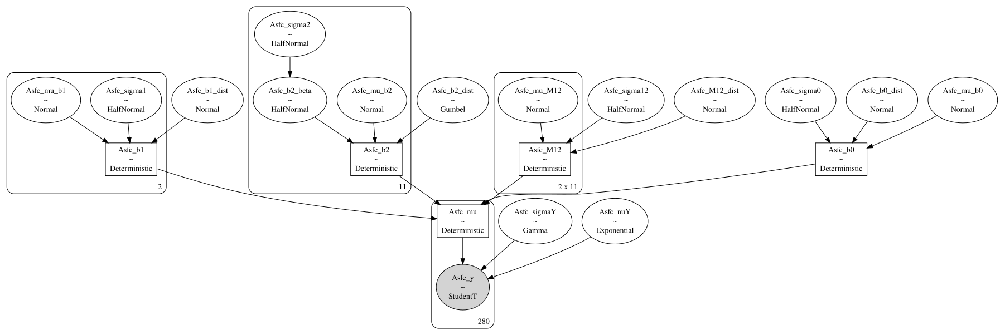

In [65]:
pm.model_to_graphviz(AsfcModel)

#### Check prior choice

In [66]:
with AsfcModel as model:
    prior_pred_Asfc = pm.sample_prior_predictive(samples=numPredSamples,random_seed=random_seed)

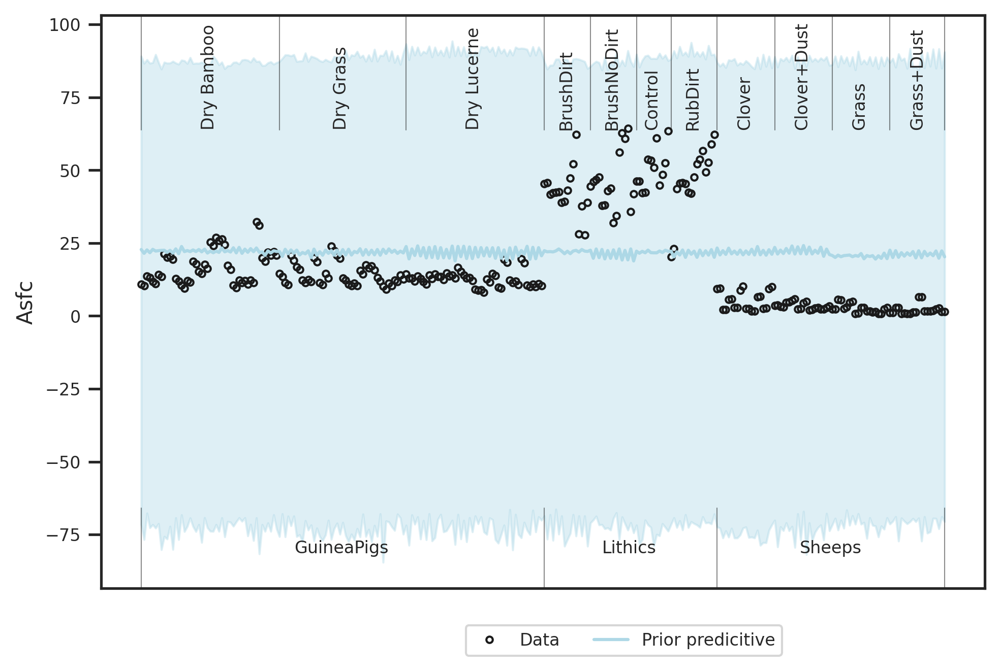

In [67]:
plotting_lib.plotPriorPredictive(widthInch,heigthInch,dpi,writeOut,outPathPlots,df,dictMeanStd,prior_pred_Asfc,dataZ["Asfc_z"].values,'Asfc')

Prior choice is as intended: Broad over the data range.

#### Sampling

In [68]:
with AsfcModel as model:
    trace_Asfc = pm.sample(numSamples,cores=numCores,tune=numTune,max_treedepth=20, init='auto',target_accept=0.99,random_seed=random_seed)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (10 chains in 10 jobs)
NUTS: [Asfc_M12_dist, Asfc_mu_M12, Asfc_b2_dist, Asfc_b2_beta, Asfc_b1_dist, Asfc_b0_dist, Asfc_sigmaY, Asfc_nuY, Asfc_sigma12, Asfc_mu_b2, Asfc_mu_b1, Asfc_mu_b0, Asfc_sigma2, Asfc_sigma1, Asfc_sigma0]


Sampling 10 chains for 1_000 tune and 500 draw iterations (10_000 + 5_000 draws total) took 931 seconds.


In [69]:
with AsfcModel as model:
    if writeOut:
        with open(outPathData + 'model_{}.pkl'.format('Asfc'), 'wb') as buff:
            pickle.dump({'model': AsfcModel, 'trace': trace_Asfc}, buff)

#### Check sampling

In [70]:
with AsfcModel as model:
    dataTrace_Asfc = az.from_pymc3(trace=trace_Asfc)

In [71]:
pm.summary(dataTrace_Asfc,hdi_prob=0.95).round(2)

,mean,sd,hdi_2.5%,hdi_97.5%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
Asfc_mu_b0,0.02,0.80,-1.56,1.56,0.01,0.01,6414.0,2566.0,6418.0,3790.0,1.0
Asfc_mu_b1[0],0.00,0.73,-1.45,1.44,0.01,0.01,5801.0,2387.0,5814.0,3868.0,1.0
Asfc_mu_b1[1],0.02,0.72,-1.42,1.41,0.01,0.01,5774.0,2489.0,5858.0,3660.0,1.0
Asfc_mu_b2[0],0.79,0.67,-0.49,2.13,0.01,0.01,5568.0,4274.0,5588.0,3081.0,1.0
Asfc_mu_b2[1],0.82,0.68,-0.47,2.17,0.01,0.01,5994.0,4271.0,5950.0,3934.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...
Asfc_mu[275],-0.99,0.06,-1.10,-0.88,0.00,0.00,4965.0,4965.0,4968.0,4536.0,1.0
Asfc_mu[276],-1.00,0.06,-1.11,-0.89,0.00,0.00,4854.0,4854.0,4859.0,4733.0,1.0
Asfc_mu[277],-0.99,0.06,-1.10,-0.88,0.00,0.00,4965.0,4965.0,4968.0,4536.0,1.0
Asfc_mu[278],-1.00,0.06,-1.11,-0.89,0.00,0.00,4854.0,4854.0,4859.0,4733.0,1.0


/home/bob/.local/lib/python3.8/site-packages/arviz/plots/backends/matplotlib/pairplot.py:212: UserWarning: rcParams['plot.max_subplots'] (40) is smaller than the number of resulting pair plots with these variables, generating only a 8x8 grid
  warnings.warn(


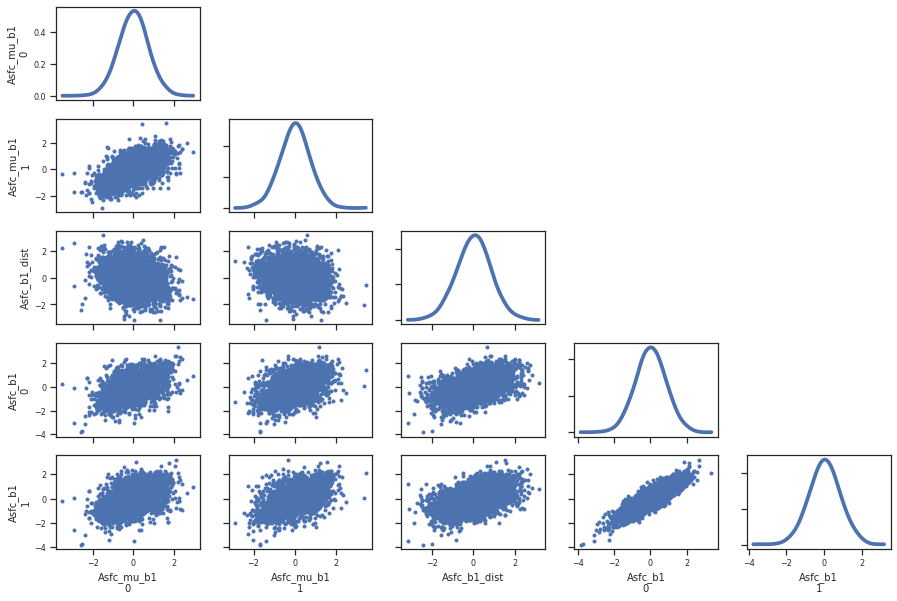

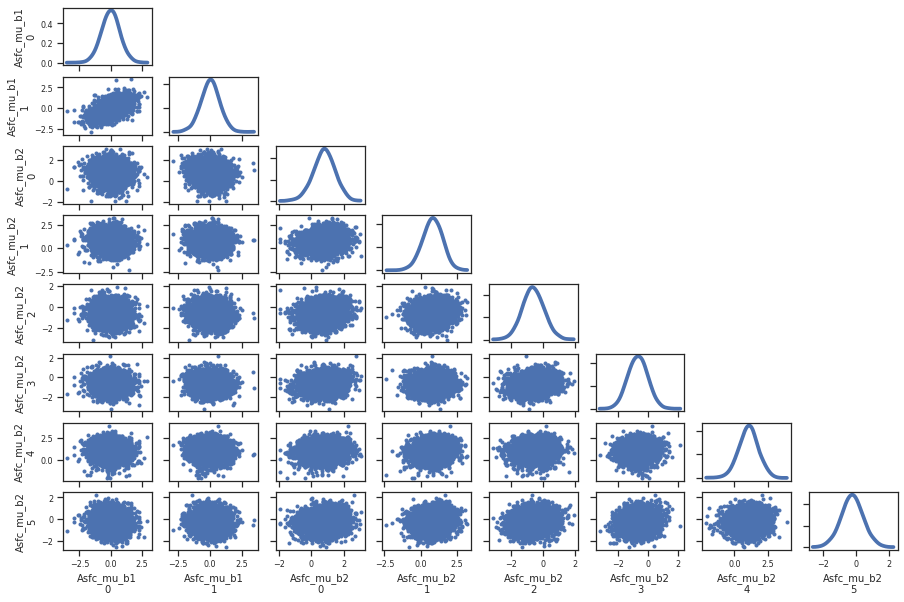

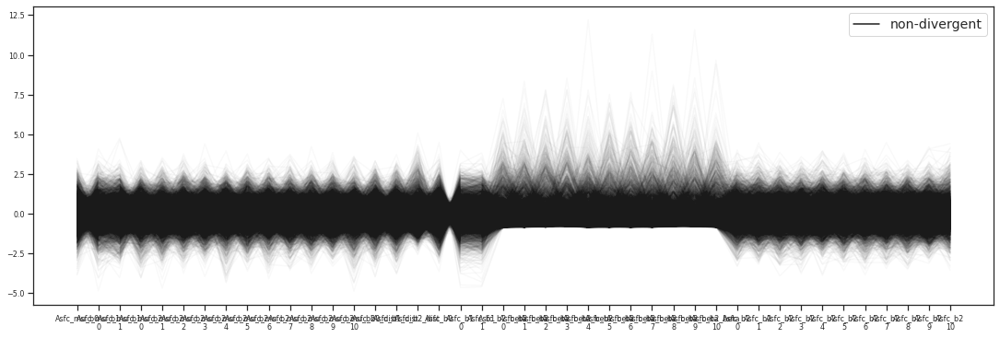

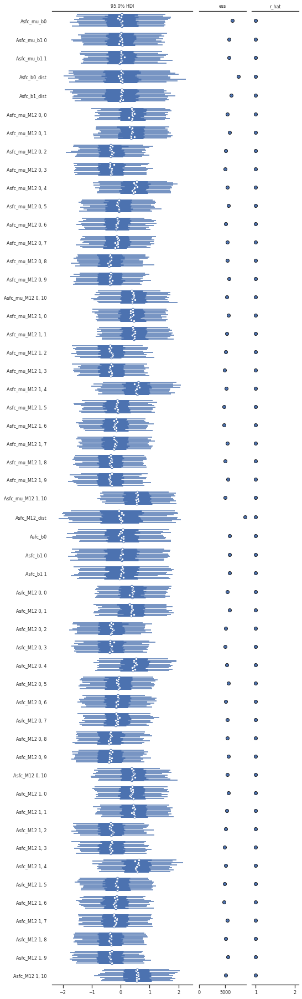

In [72]:
plotting_lib.plotDiagnostics(widthInch,heigthInch,dpi,writeOut,outPathPlots,trace_Asfc,dataTrace_Asfc,'Asfc')

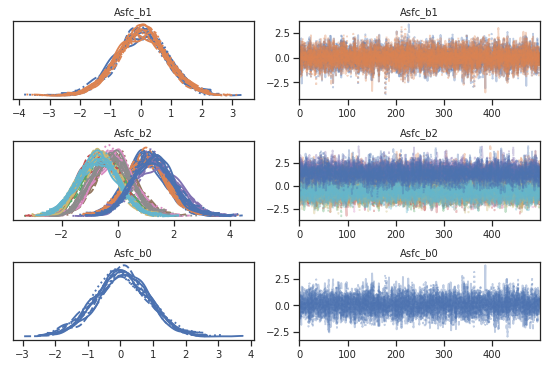

In [73]:
with AsfcModel as model:
    plotting_lib.plotTracesB(widthInch,heigthInch,dpi,writeOut,outPathPlots,trace_Asfc,'Asfc')

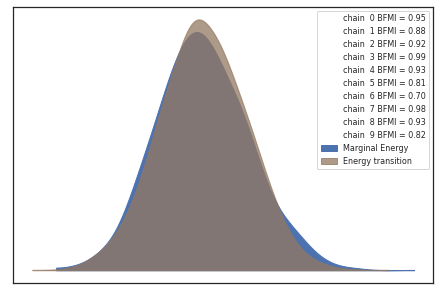

In [74]:
with AsfcModel as model:
    plotting_lib.pm.energyplot(trace_Asfc)

#### Posterior predictive distribution

In [75]:
with AsfcModel as model:
    posterior_pred_Asfc = pm.sample_posterior_predictive(trace_Asfc,samples=numPredSamples,random_seed=random_seed)

/home/bob/.local/lib/python3.8/site-packages/pymc3/sampling.py:1707: UserWarning: samples parameter is smaller than nchains times ndraws, some draws and/or chains may not be represented in the returned posterior predictive sample
  warnings.warn(


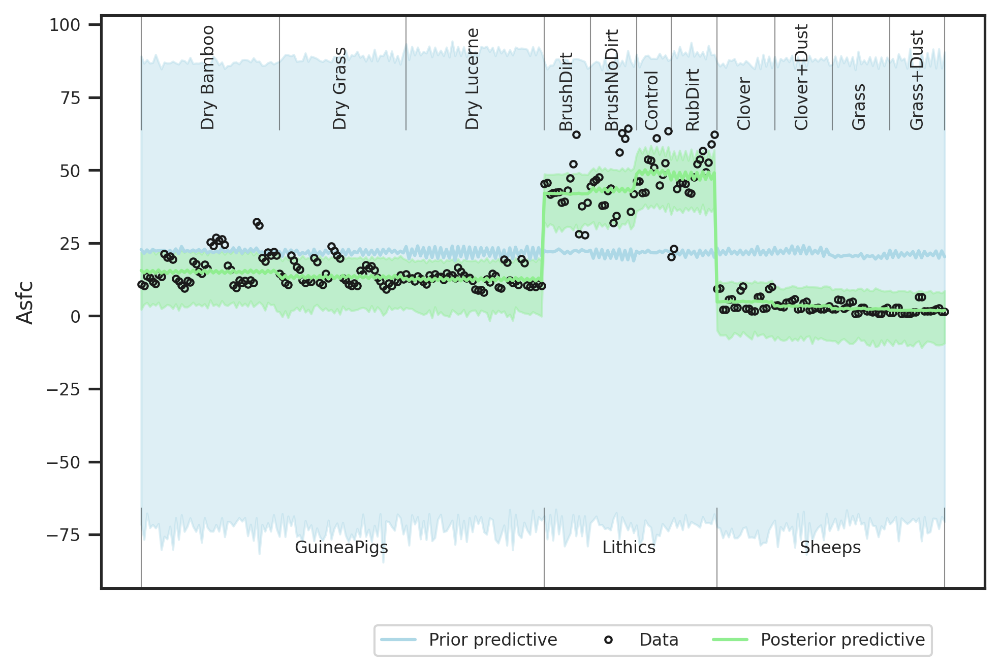

In [76]:
plotting_lib.plotPriorPosteriorPredictive(widthInch,heigthInch,dpi,writeOut,outPathPlots,df,dictMeanStd,prior_pred_Asfc,posterior_pred_Asfc,dataZ["Asfc_z"].values,'Asfc')

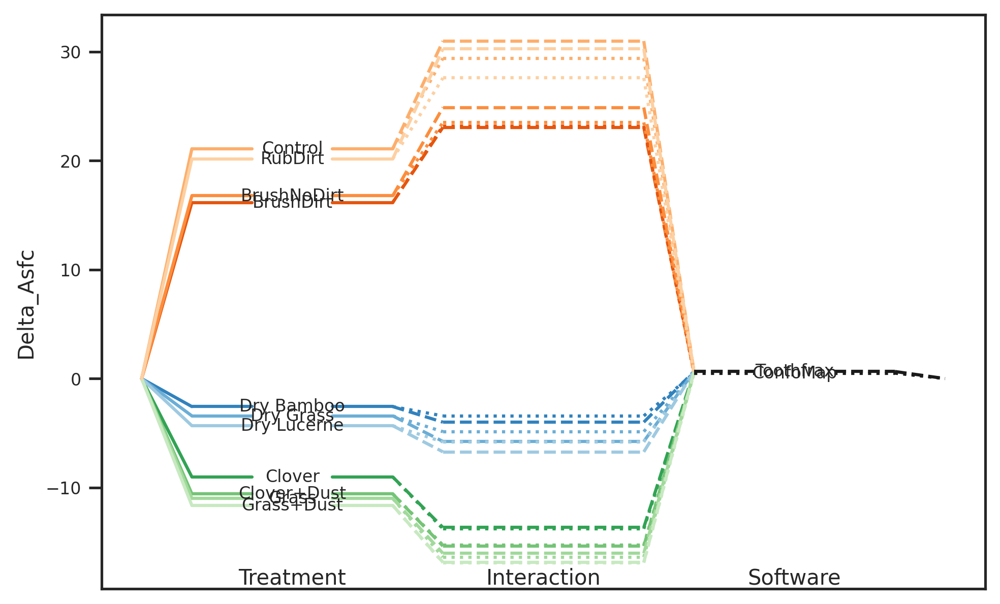

In [77]:
plotting_lib.plotLevels(widthInch,heigthInch,dpi,sizes,writeOut,outPathPlots,dictMeanStd,dictTreatment,dictSoftware,trace_Asfc,'Asfc',x1,x2)

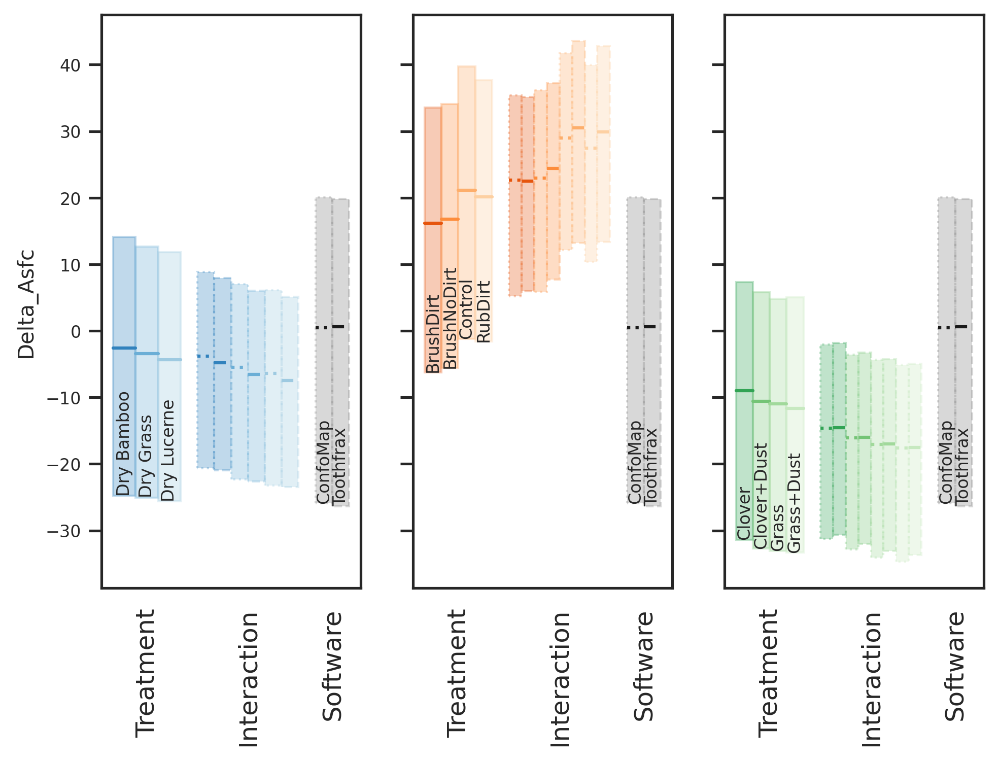

In [78]:
plotting_lib.plotLevelsStd(widthInch,heigthInch,dpi,sizes,writeOut,outPathPlots,dictMeanStd,dictTreatment,dictSoftware,trace_Asfc,'Asfc',x1,x2)

#### Compare prior and posterior for model parameters

In [79]:
with AsfcModel as model:
    pm_data_Asfc = az.from_pymc3(trace=trace_Asfc,prior=prior_pred_Asfc,posterior_predictive=posterior_pred_Asfc)

arviz.data.io_pymc3 - WARNING - posterior predictive variable Asfc_y's shape not compatible with number of chains and draws. This can mean that some draws or even whole chains are not represented.


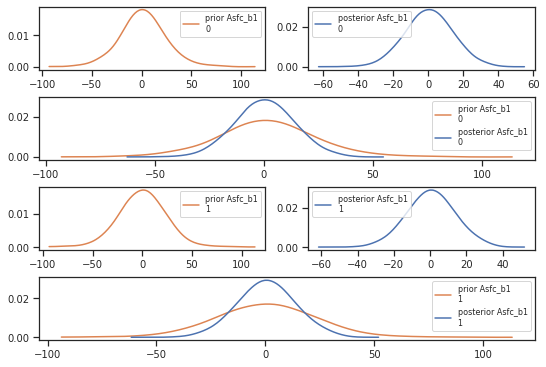

In [80]:
plotting_lib.plotPriorPosteriorB(widthInch,heigthInch,dpi,sizes,writeOut,outPathPlots,dictMeanStd,pm_data_Asfc,'Asfc')

#### Posterior and contrasts

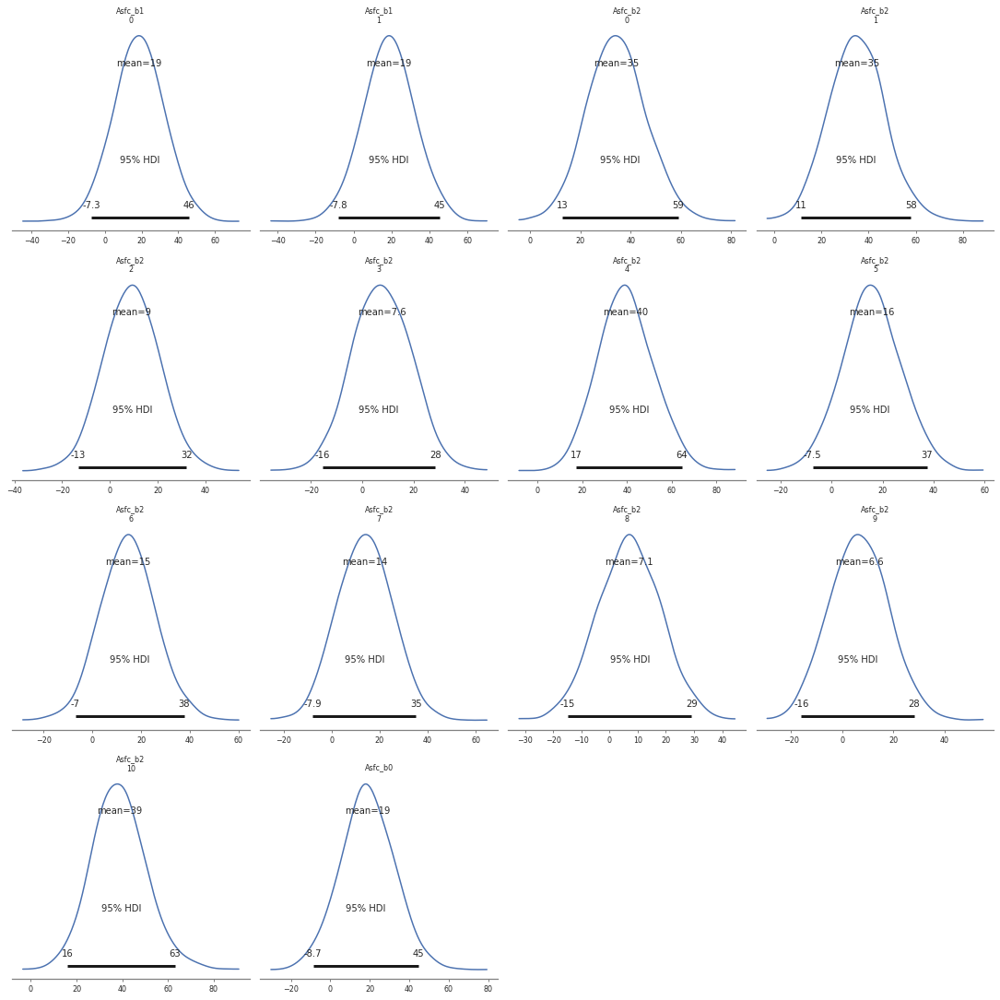

In [81]:
plotting_lib.plotPosterior(widthInch,heigthInch,dpi,writeOut,outPathPlots,dictMeanStd,pm_data_Asfc,'Asfc')

In [82]:
df_hdi_Asfc = plotting_lib.plotTreatmentPosterior(widthInch,heigthInch,dpi,sizes,writeOut,outPathPlots,dictMeanStd,dictTreatment,dictSoftware,trace_Asfc,'Asfc',x1,x2)

In [84]:
df_hdi_Asfc

,Treatment_i,Treatment_j,hdi_ConfoMap_2.5%,hdi_ConfoMap_97.5%,isSignificant_on_ConfoMap,hdi_Toothfrax_2.5%,hdi_Toothfrax_97.5%,isSignificant_on_Toothfrax
0,Dry Grass,Dry Bamboo,-4.590184,1.147175,False,-4.558174,0.815497,False
1,Dry Lucerne,Dry Bamboo,-5.494453,-0.013526,True,-5.244830,-0.130161,True
2,Dry Lucerne,Dry Grass,-3.003669,1.160887,False,-2.904640,1.154366,False
3,BrushNoDirt,BrushDirt,-4.739801,5.943660,False,-3.249920,6.365292,False
4,Control,BrushDirt,1.157339,11.554010,True,1.327801,14.288748,True
5,Control,BrushNoDirt,-0.023134,12.236542,False,-0.655977,13.044664,False
6,RubDirt,BrushDirt,0.315135,9.771061,True,1.263154,13.157769,True
7,RubDirt,BrushNoDirt,-0.902446,10.179298,False,-0.778604,11.638509,False
8,RubDirt,Control,-6.656884,3.955110,False,-8.631530,6.598749,False
9,Clover+Dust,Clover,-4.401580,1.531404,False,-4.469708,1.591586,False


In [85]:
if writeOut:
    df_hdi_Asfc.to_csv(outPathData+ 'hdi_{}.csv'.format('Asfc'))

### 	Smfc  <a name="Smfc"></a>

In [86]:
with pm.Model() as model:
    SmfcModel = TwoFactorModel('Smfc',x1,x2,dataZ.Smfc_z.values)

#### Verify model settings

In [87]:
SmfcModel.printParams(x1,x2,dataZ.Smfc_z.values)

The number of levels of the x variables are (2, 11)
The standard deviations used for the beta priors are  (1.3943421938332237, 3.387697874270125)
The standard deviations used for the M12 priors are 0.18317127941381783


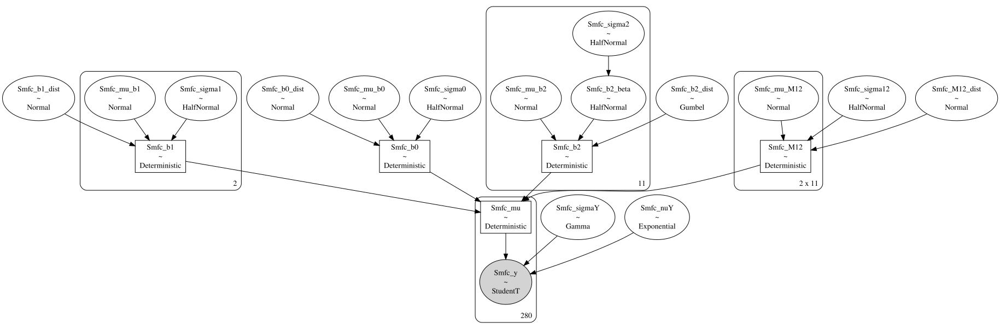

In [88]:
pm.model_to_graphviz(SmfcModel)

#### Check prior choice

In [89]:
with SmfcModel as model:
    prior_pred_Smfc = pm.sample_prior_predictive(samples=numPredSamples,random_seed=random_seed)

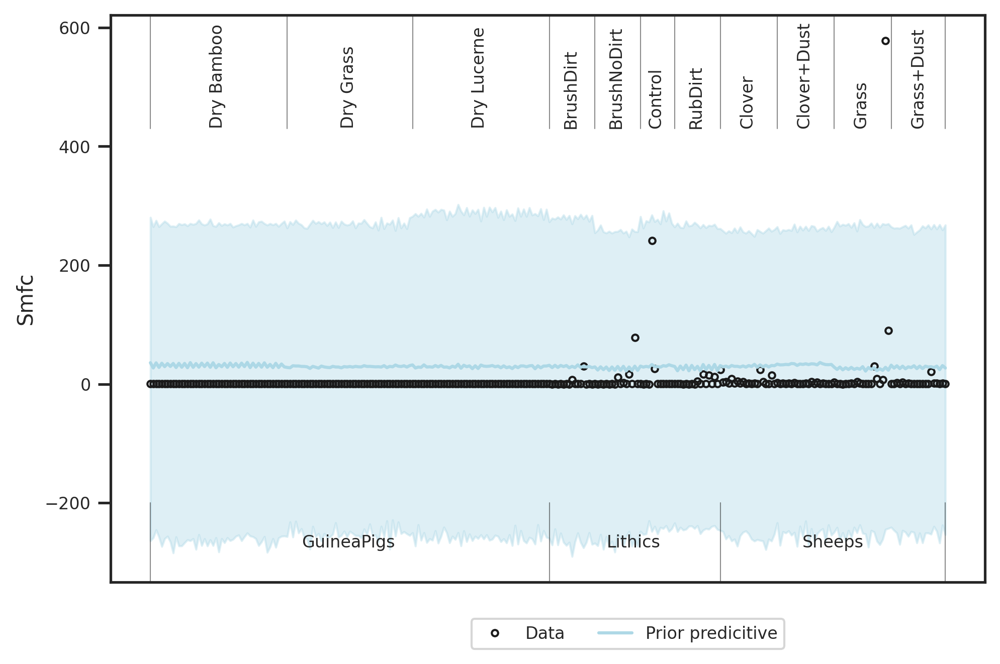

In [90]:
plotting_lib.plotPriorPredictive(widthInch,heigthInch,dpi,writeOut,outPathPlots,df,dictMeanStd,prior_pred_Smfc,dataZ.Smfc_z.values,'Smfc')

Prior choice is as intended: Broad over the data range.

#### Sampling

In [91]:
with SmfcModel as model:
    trace_Smfc = pm.sample(numSamples,cores=numCores,tune=numTune,max_treedepth=20, init='auto',target_accept=0.99,random_seed=random_seed)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (10 chains in 10 jobs)
NUTS: [Smfc_M12_dist, Smfc_mu_M12, Smfc_b2_dist, Smfc_b2_beta, Smfc_b1_dist, Smfc_b0_dist, Smfc_sigmaY, Smfc_nuY, Smfc_sigma12, Smfc_mu_b2, Smfc_mu_b1, Smfc_mu_b0, Smfc_sigma2, Smfc_sigma1, Smfc_sigma0]


ValueError: Not enough samples to build a trace.

Analysis stopped here because sampling did not converge.
As the plot shows, some data points are very far away from the others, which would require the analysis to be based on more heavy-tailed distributions.

### HAsfc9 <a name="HAsfc9"></a>

In [92]:
with pm.Model() as model:
    HAsfc9Model = TwoFactorModel('HAsfc9',x1,x2,dataZ["HAsfc9_z"].values)

#### Verify model settings

In [93]:
HAsfc9Model.printParams(x1,x2,dataZ["HAsfc9_z"].values)

The number of levels of the x variables are (2, 11)
The standard deviations used for the beta priors are  (1.0299664523718457, 2.0653529113379627)
The standard deviations used for the M12 priors are 0.11539620380870036


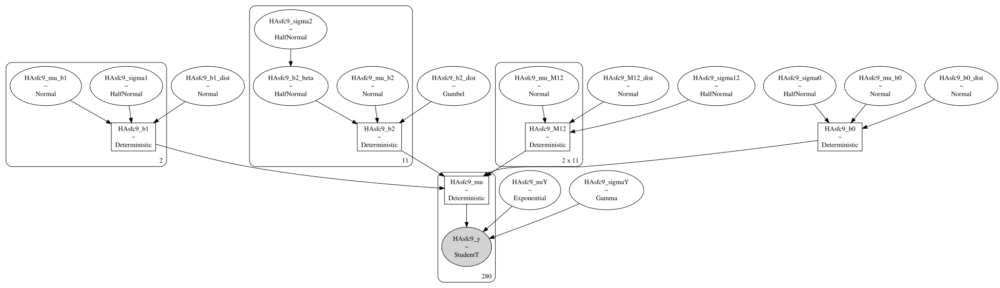

In [94]:
pm.model_to_graphviz(HAsfc9Model)

#### Check prior choice

In [95]:
with HAsfc9Model as model:
    prior_pred_HAsfc9 = pm.sample_prior_predictive(samples=numPredSamples,random_seed=random_seed)

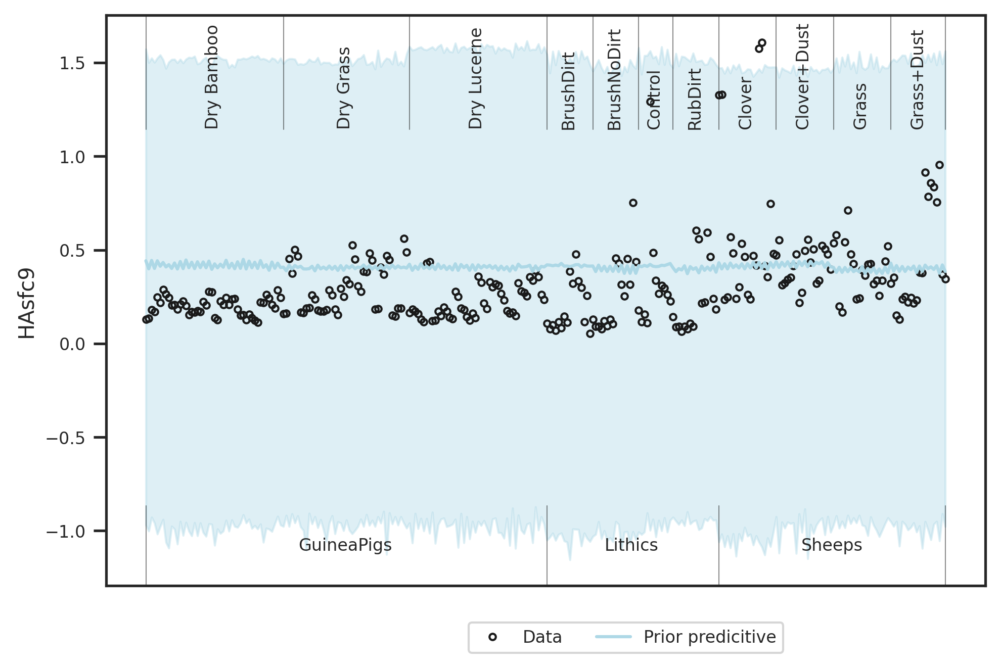

In [96]:
plotting_lib.plotPriorPredictive(widthInch,heigthInch,dpi,writeOut,outPathPlots,df,dictMeanStd,prior_pred_HAsfc9,dataZ["HAsfc9_z"].values,'HAsfc9')

Prior choice is as intended: Broad over the data range.

#### Sampling

In [97]:
with HAsfc9Model as model:
    trace_HAsfc9 = pm.sample(numSamples,cores=numCores,tune=numTune,max_treedepth=20, init='auto',target_accept=0.99,random_seed=random_seed)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (10 chains in 10 jobs)
NUTS: [HAsfc9_M12_dist, HAsfc9_mu_M12, HAsfc9_b2_dist, HAsfc9_b2_beta, HAsfc9_b1_dist, HAsfc9_b0_dist, HAsfc9_sigmaY, HAsfc9_nuY, HAsfc9_sigma12, HAsfc9_mu_b2, HAsfc9_mu_b1, HAsfc9_mu_b0, HAsfc9_sigma2, HAsfc9_sigma1, HAsfc9_sigma0]


Sampling 10 chains for 1_000 tune and 500 draw iterations (10_000 + 5_000 draws total) took 394 seconds.


In [98]:
with HAsfc9Model as model:
    if writeOut:
        with open(outPathData + 'model_{}.pkl'.format('HAsfc9'), 'wb') as buff:
            pickle.dump({'model': HAsfc9Model, 'trace': trace_HAsfc9}, buff)

#### Check sampling

In [99]:
with HAsfc9Model as model:
    dataTrace_HAsfc9 = az.from_pymc3(trace=trace_HAsfc9)

In [100]:
pm.summary(dataTrace_HAsfc9,hdi_prob=0.95).round(2)

,mean,sd,hdi_2.5%,hdi_97.5%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
HAsfc9_mu_b0,-0.07,0.83,-1.66,1.58,0.01,0.01,5152.0,2742.0,5154.0,3850.0,1.0
HAsfc9_mu_b1[0],0.01,0.72,-1.38,1.49,0.01,0.01,4806.0,2997.0,4806.0,3874.0,1.0
HAsfc9_mu_b1[1],-0.08,0.73,-1.46,1.42,0.01,0.01,4874.0,2965.0,4873.0,4131.0,1.0
HAsfc9_mu_b2[0],-0.30,0.66,-1.64,0.95,0.01,0.01,4119.0,3526.0,4134.0,3967.0,1.0
HAsfc9_mu_b2[1],-0.17,0.68,-1.47,1.20,0.01,0.01,4664.0,3355.0,4667.0,4027.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...
HAsfc9_mu[275],0.01,0.20,-0.37,0.43,0.00,0.00,5151.0,4276.0,5148.0,4522.0,1.0
HAsfc9_mu[276],-0.03,0.21,-0.44,0.39,0.00,0.00,4911.0,3439.0,4923.0,4077.0,1.0
HAsfc9_mu[277],0.01,0.20,-0.37,0.43,0.00,0.00,5151.0,4276.0,5148.0,4522.0,1.0
HAsfc9_mu[278],-0.03,0.21,-0.44,0.39,0.00,0.00,4911.0,3439.0,4923.0,4077.0,1.0


/home/bob/.local/lib/python3.8/site-packages/arviz/plots/backends/matplotlib/pairplot.py:212: UserWarning: rcParams['plot.max_subplots'] (40) is smaller than the number of resulting pair plots with these variables, generating only a 8x8 grid
  warnings.warn(


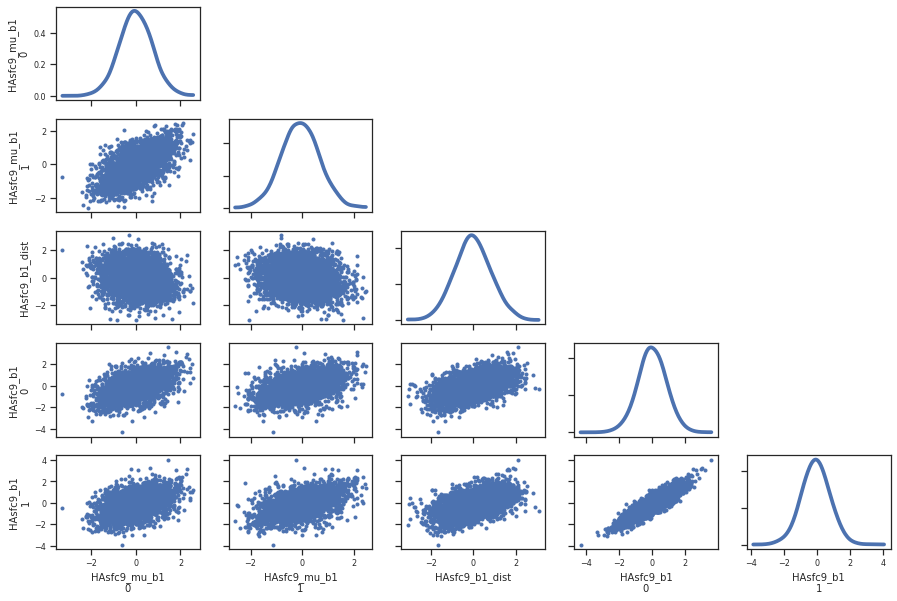

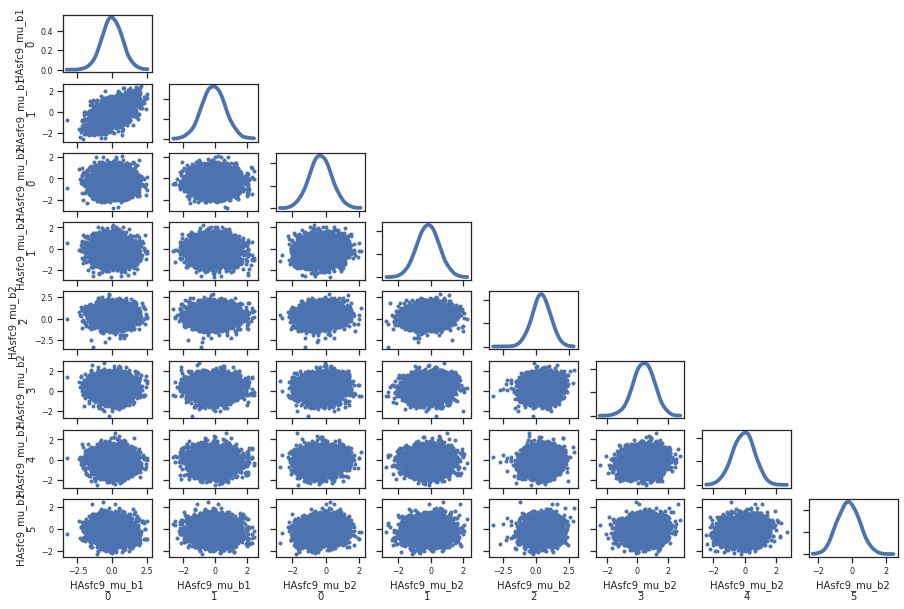

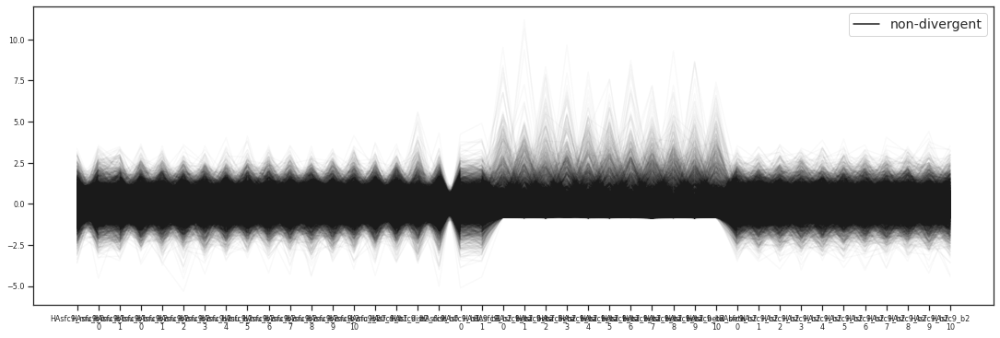

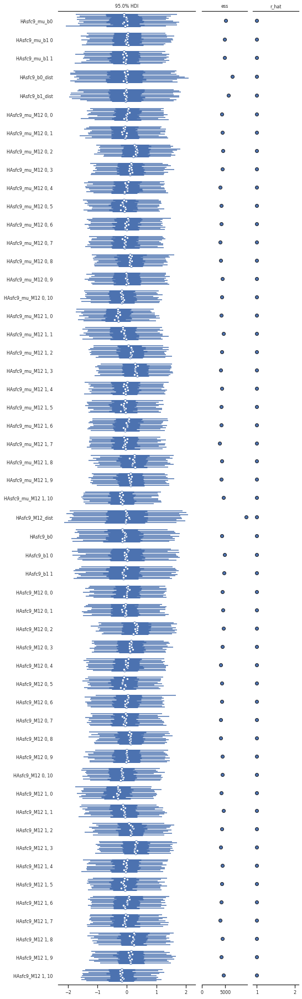

In [101]:
plotting_lib.plotDiagnostics(widthInch,heigthInch,dpi,writeOut,outPathPlots,trace_HAsfc9,dataTrace_HAsfc9,'HAsfc9')

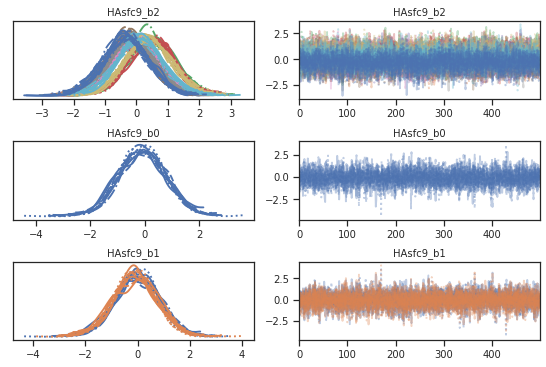

In [102]:
with HAsfc9Model as model:
    plotting_lib.plotTracesB(widthInch,heigthInch,dpi,writeOut,outPathPlots,trace_HAsfc9,'HAsfc9')

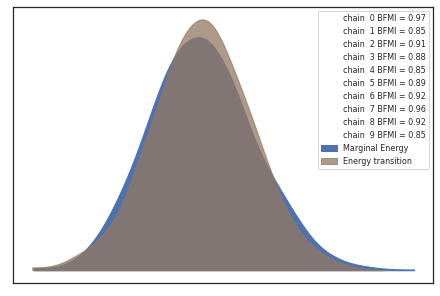

In [103]:
with HAsfc9Model as model:
    plotting_lib.pm.energyplot(trace_HAsfc9)

#### Posterior predictive distribution

In [104]:
with HAsfc9Model as model:
    posterior_pred_HAsfc9 = pm.sample_posterior_predictive(trace_HAsfc9,samples=numPredSamples,random_seed=random_seed)

/home/bob/.local/lib/python3.8/site-packages/pymc3/sampling.py:1707: UserWarning: samples parameter is smaller than nchains times ndraws, some draws and/or chains may not be represented in the returned posterior predictive sample
  warnings.warn(


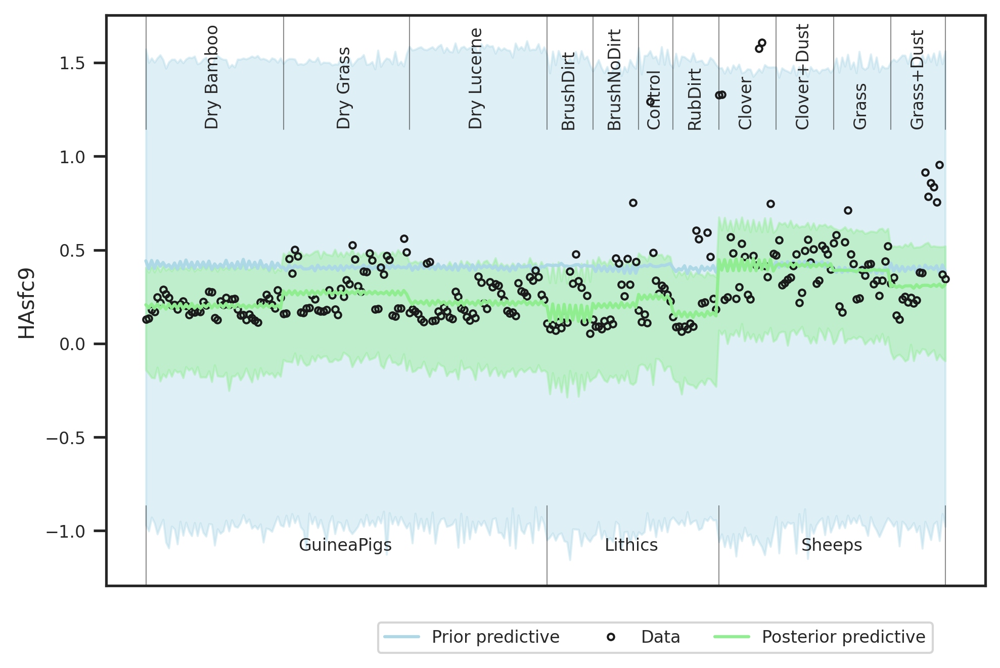

In [105]:
plotting_lib.plotPriorPosteriorPredictive(widthInch,heigthInch,dpi,writeOut,outPathPlots,df,dictMeanStd,prior_pred_HAsfc9,posterior_pred_HAsfc9,dataZ["HAsfc9_z"].values,'HAsfc9')

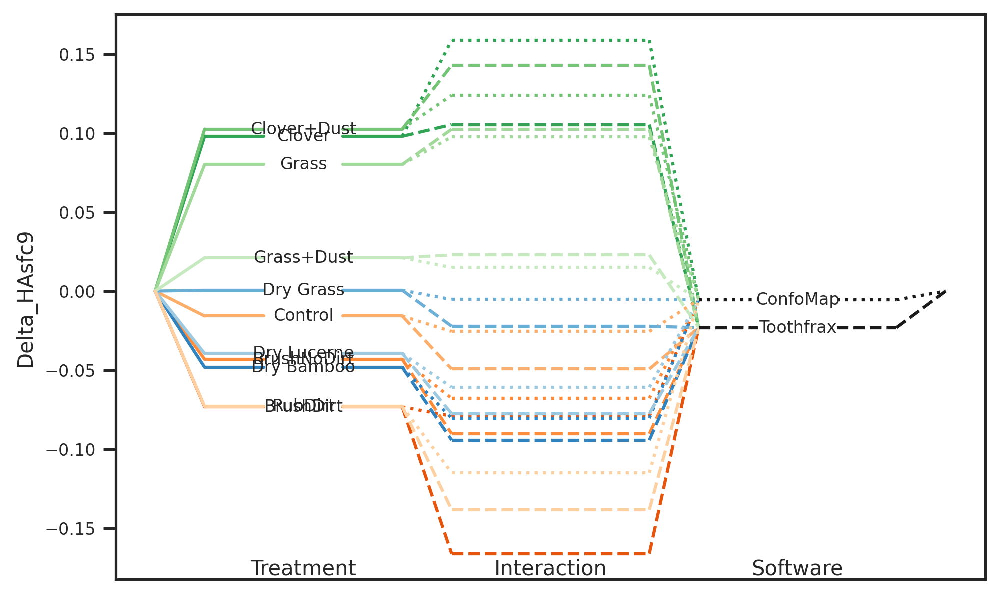

In [106]:
plotting_lib.plotLevels(widthInch,heigthInch,dpi,sizes,writeOut,outPathPlots,dictMeanStd,dictTreatment,dictSoftware,trace_HAsfc9,'HAsfc9',x1,x2)

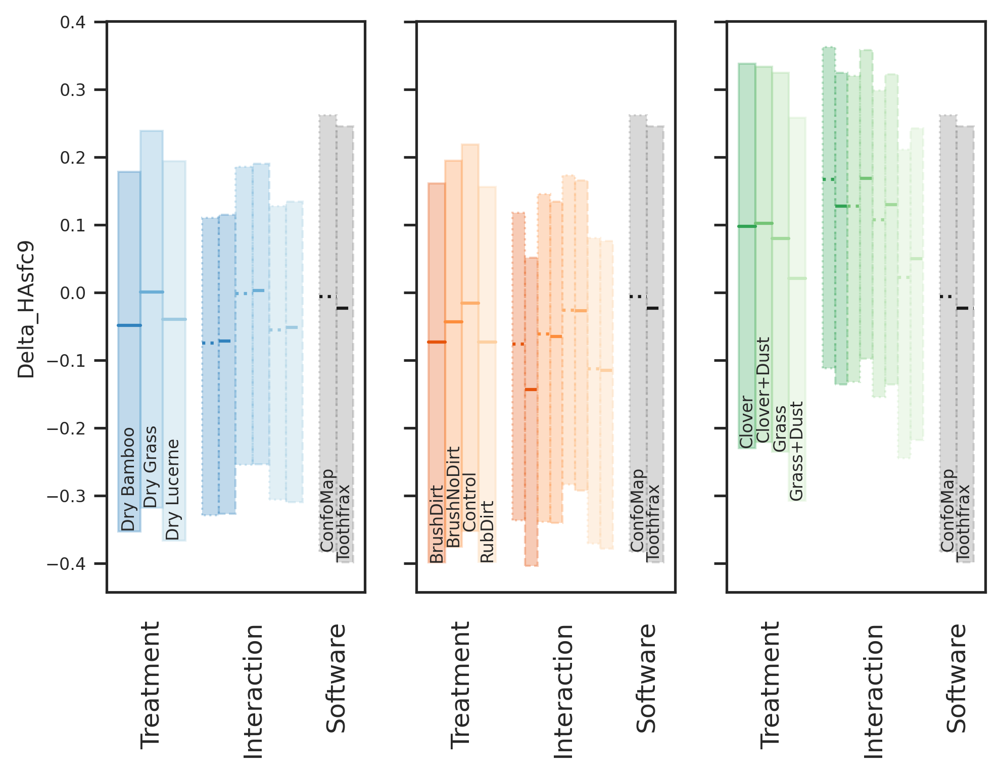

In [107]:
plotting_lib.plotLevelsStd(widthInch,heigthInch,dpi,sizes,writeOut,outPathPlots,dictMeanStd,dictTreatment,dictSoftware,trace_HAsfc9,'HAsfc9',x1,x2)

#### Compare prior and posterior for model parameters

In [108]:
with HAsfc9Model as model:
    pm_data_HAsfc9 = az.from_pymc3(trace=trace_HAsfc9,prior=prior_pred_HAsfc9,posterior_predictive=posterior_pred_HAsfc9)

arviz.data.io_pymc3 - WARNING - posterior predictive variable HAsfc9_y's shape not compatible with number of chains and draws. This can mean that some draws or even whole chains are not represented.


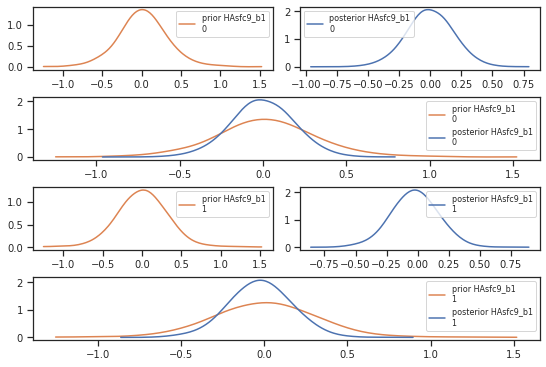

In [109]:
plotting_lib.plotPriorPosteriorB(widthInch,heigthInch,dpi,sizes,writeOut,outPathPlots,dictMeanStd,pm_data_HAsfc9,'HAsfc9')

#### Posterior and contrasts

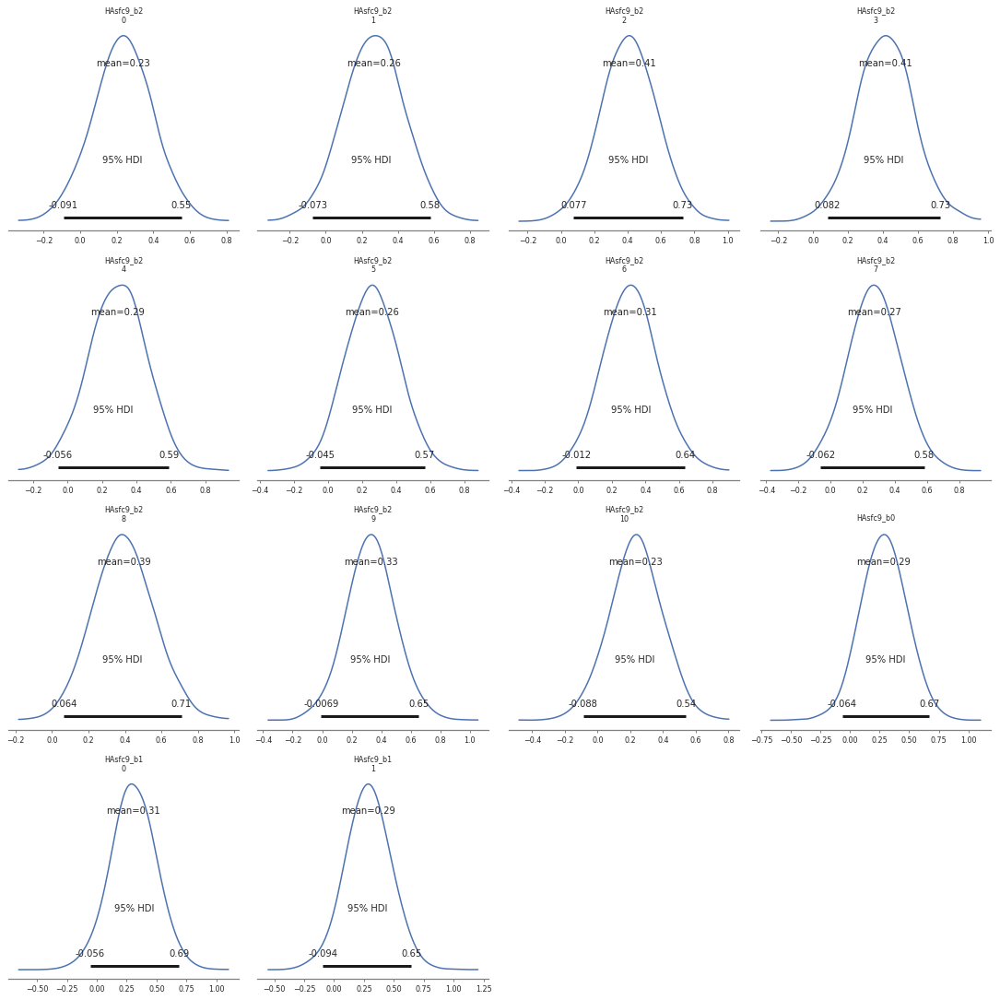

In [110]:
plotting_lib.plotPosterior(widthInch,heigthInch,dpi,writeOut,outPathPlots,dictMeanStd,pm_data_HAsfc9,'HAsfc9')

In [111]:
df_hdi_HAsfc9 = plotting_lib.plotTreatmentPosterior(widthInch,heigthInch,dpi,sizes,writeOut,outPathPlots,dictMeanStd,dictTreatment,dictSoftware,trace_HAsfc9,'HAsfc9',x1,x2)

In [112]:
df_hdi_Asfc = plotting_lib.plotTreatmentPosterior(widthInch,heigthInch,dpi,sizes,writeOut,outPathPlots,dictMeanStd,dictTreatment,dictSoftware,trace_Asfc,'Asfc',x1,x2)

In [113]:
df_hdi_HAsfc9

,Treatment_i,Treatment_j,hdi_ConfoMap_2.5%,hdi_ConfoMap_97.5%,isSignificant_on_ConfoMap,hdi_Toothfrax_2.5%,hdi_Toothfrax_97.5%,isSignificant_on_Toothfrax
0,Dry Grass,Dry Bamboo,0.004741,0.154269,True,0.009964,0.146980,True
1,Dry Lucerne,Dry Bamboo,-0.039222,0.077737,False,-0.035389,0.075596,False
2,Dry Lucerne,Dry Grass,-0.135338,0.023288,False,-0.125951,0.018912,False
3,BrushNoDirt,BrushDirt,-0.154694,0.173059,False,-0.051301,0.218016,False
4,Control,BrushDirt,-0.096697,0.183108,False,-0.014656,0.238499,False
5,Control,BrushNoDirt,-0.129790,0.194543,False,-0.115211,0.189870,False
6,RubDirt,BrushDirt,-0.173911,0.089835,False,-0.088172,0.144856,False
7,RubDirt,BrushNoDirt,-0.217105,0.097660,False,-0.194993,0.099310,False
8,RubDirt,Control,-0.224113,0.034596,False,-0.220132,0.051093,False
9,Clover+Dust,Clover,-0.174753,0.114866,False,-0.082380,0.151813,False


In [114]:
if writeOut:
    df_hdi_HAsfc9.to_csv(outPathData+ 'hdi_{}.csv'.format('HAsfc9'))

### HAsfc81 <a name="HAsfc81"></a>

In [115]:
with pm.Model() as model:
    HAsfc81Model = TwoFactorModel('HAsfc81',x1,x2,dataZ["HAsfc81_z"].values)

#### Verify model settings

In [116]:
HAsfc81Model.printParams(x1,x2,dataZ["HAsfc81_z"].values)

The number of levels of the x variables are (2, 11)
The standard deviations used for the beta priors are  (1.0035538697180921, 1.674345831114272)
The standard deviations used for the M12 priors are 0.09760320603847883


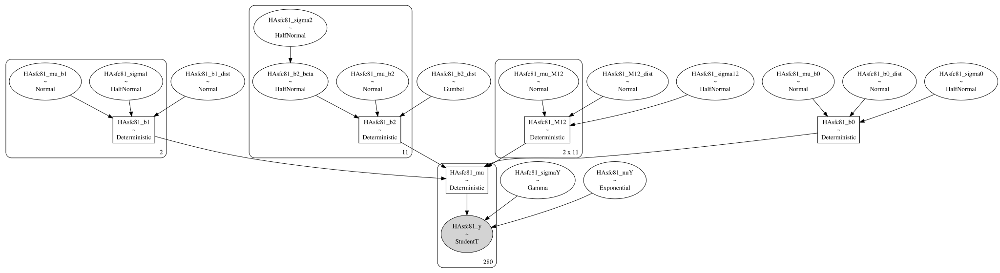

In [117]:
pm.model_to_graphviz(HAsfc81Model)

#### Check prior choice

In [118]:
with HAsfc81Model as model:
    prior_pred_HAsfc81 = pm.sample_prior_predictive(samples=numPredSamples,random_seed=random_seed)

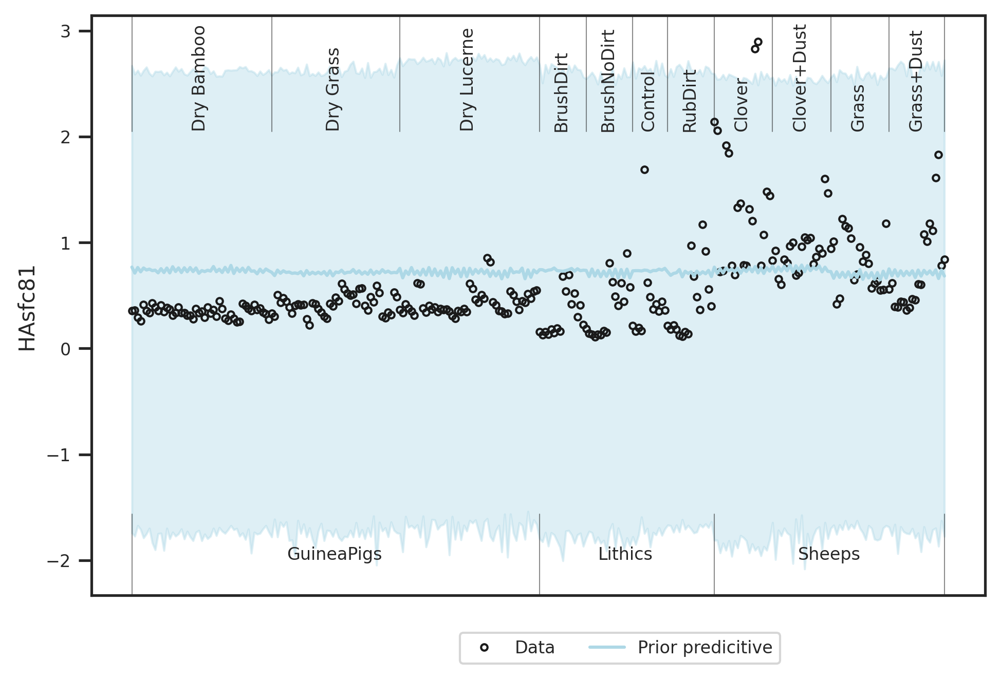

In [119]:
plotting_lib.plotPriorPredictive(widthInch,heigthInch,dpi,writeOut,outPathPlots,df,dictMeanStd,prior_pred_HAsfc81,dataZ["HAsfc81_z"].values,'HAsfc81')

Prior choice is as intended: Broad over the data range.

#### Sampling

In [120]:
with HAsfc81Model as model:
    trace_HAsfc81 = pm.sample(numSamples,cores=numCores,tune=numTune,max_treedepth=20, init='auto',target_accept=0.99,random_seed=random_seed)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (10 chains in 10 jobs)
NUTS: [HAsfc81_M12_dist, HAsfc81_mu_M12, HAsfc81_b2_dist, HAsfc81_b2_beta, HAsfc81_b1_dist, HAsfc81_b0_dist, HAsfc81_sigmaY, HAsfc81_nuY, HAsfc81_sigma12, HAsfc81_mu_b2, HAsfc81_mu_b1, HAsfc81_mu_b0, HAsfc81_sigma2, HAsfc81_sigma1, HAsfc81_sigma0]


Sampling 10 chains for 1_000 tune and 500 draw iterations (10_000 + 5_000 draws total) took 642 seconds.


In [121]:
with HAsfc81Model as model:
    if writeOut:
        with open(outPathData + 'model_{}.pkl'.format('HAsfc81'), 'wb') as buff:
            pickle.dump({'model': HAsfc81Model, 'trace': trace_HAsfc81}, buff)

#### Check sampling

In [122]:
with HAsfc81Model as model:
    dataTrace_HAsfc81 = az.from_pymc3(trace=trace_HAsfc81)

In [123]:
pm.summary(dataTrace_HAsfc81,hdi_prob=0.95).round(2)

,mean,sd,hdi_2.5%,hdi_97.5%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
HAsfc81_mu_b0,-0.08,0.79,-1.63,1.47,0.01,0.01,5680.0,2624.0,5669.0,3994.0,1.0
HAsfc81_mu_b1[0],-0.04,0.71,-1.38,1.38,0.01,0.01,5284.0,2779.0,5277.0,3962.0,1.0
HAsfc81_mu_b1[1],-0.01,0.70,-1.44,1.33,0.01,0.01,5321.0,2812.0,5321.0,3952.0,1.0
HAsfc81_mu_b2[0],-0.41,0.66,-1.70,0.88,0.01,0.01,4284.0,3170.0,4276.0,3847.0,1.0
HAsfc81_mu_b2[1],-0.40,0.68,-1.70,0.96,0.01,0.01,4457.0,3595.0,4455.0,3814.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...
HAsfc81_mu[275],-0.10,0.18,-0.40,0.26,0.00,0.00,4839.0,4614.0,4936.0,4783.0,1.0
HAsfc81_mu[276],-0.12,0.15,-0.41,0.16,0.00,0.00,5236.0,4918.0,5285.0,4728.0,1.0
HAsfc81_mu[277],-0.10,0.18,-0.40,0.26,0.00,0.00,4839.0,4614.0,4936.0,4783.0,1.0
HAsfc81_mu[278],-0.12,0.15,-0.41,0.16,0.00,0.00,5236.0,4918.0,5285.0,4728.0,1.0


/home/bob/.local/lib/python3.8/site-packages/arviz/plots/backends/matplotlib/pairplot.py:212: UserWarning: rcParams['plot.max_subplots'] (40) is smaller than the number of resulting pair plots with these variables, generating only a 8x8 grid
  warnings.warn(


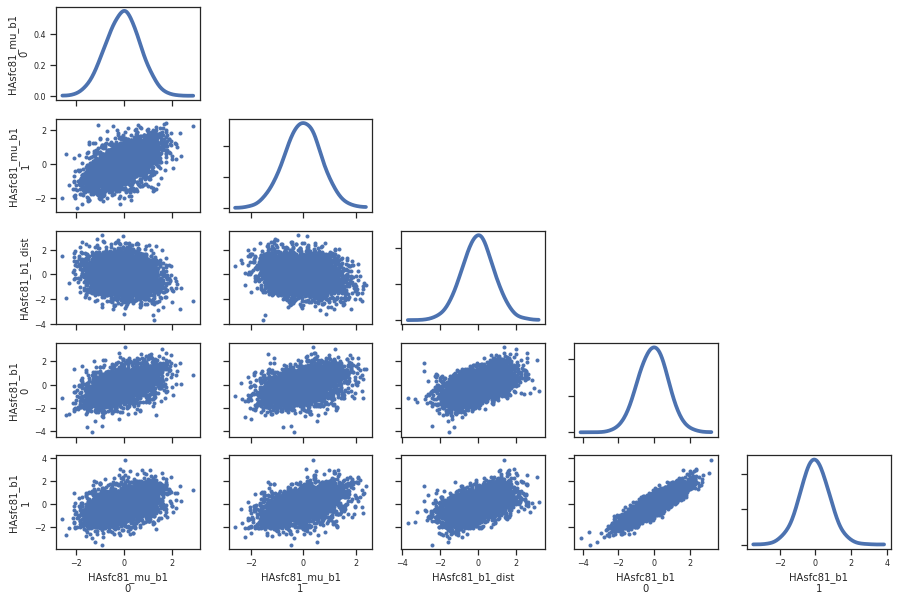

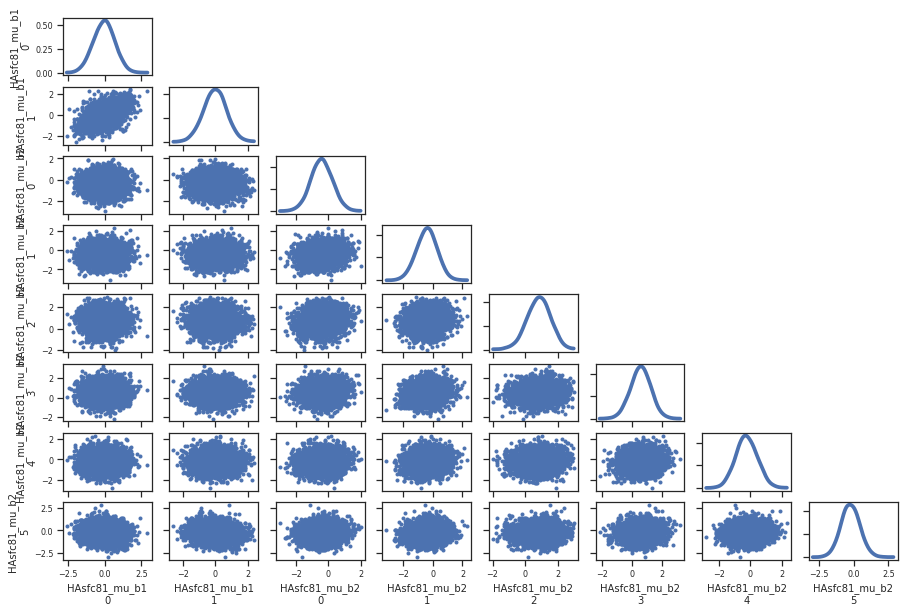

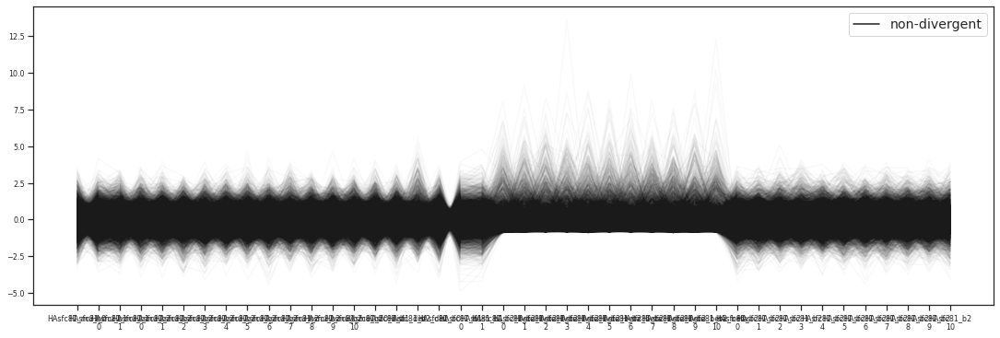

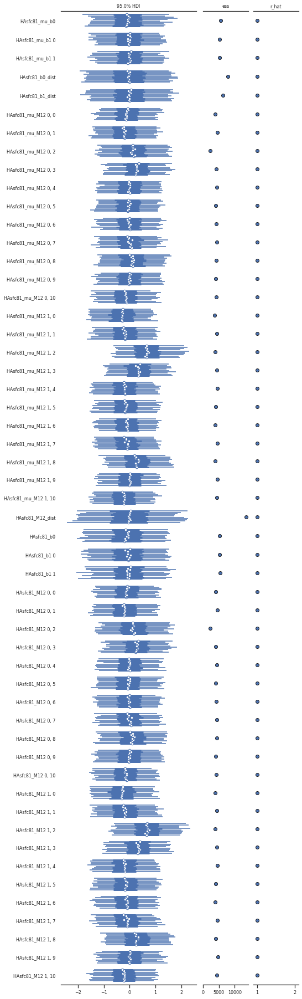

In [124]:
plotting_lib.plotDiagnostics(widthInch,heigthInch,dpi,writeOut,outPathPlots,trace_HAsfc81,dataTrace_HAsfc81,'HAsfc81')

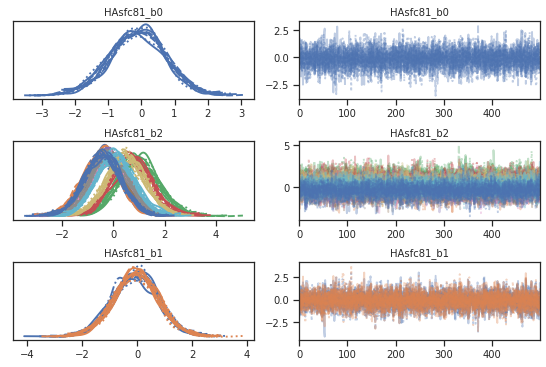

In [125]:
with HAsfc81Model as model:
    plotting_lib.plotTracesB(widthInch,heigthInch,dpi,writeOut,outPathPlots,trace_HAsfc81,'HAsfc81')

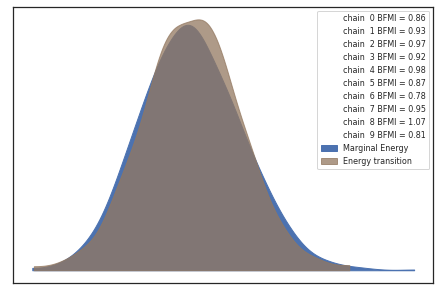

In [126]:
with HAsfc81Model as model:
    plotting_lib.pm.energyplot(trace_HAsfc81)

#### Posterior predictive distribution

In [127]:
with HAsfc81Model as model:
    posterior_pred_HAsfc81 = pm.sample_posterior_predictive(trace_HAsfc81,samples=numPredSamples,random_seed=random_seed)

/home/bob/.local/lib/python3.8/site-packages/pymc3/sampling.py:1707: UserWarning: samples parameter is smaller than nchains times ndraws, some draws and/or chains may not be represented in the returned posterior predictive sample
  warnings.warn(


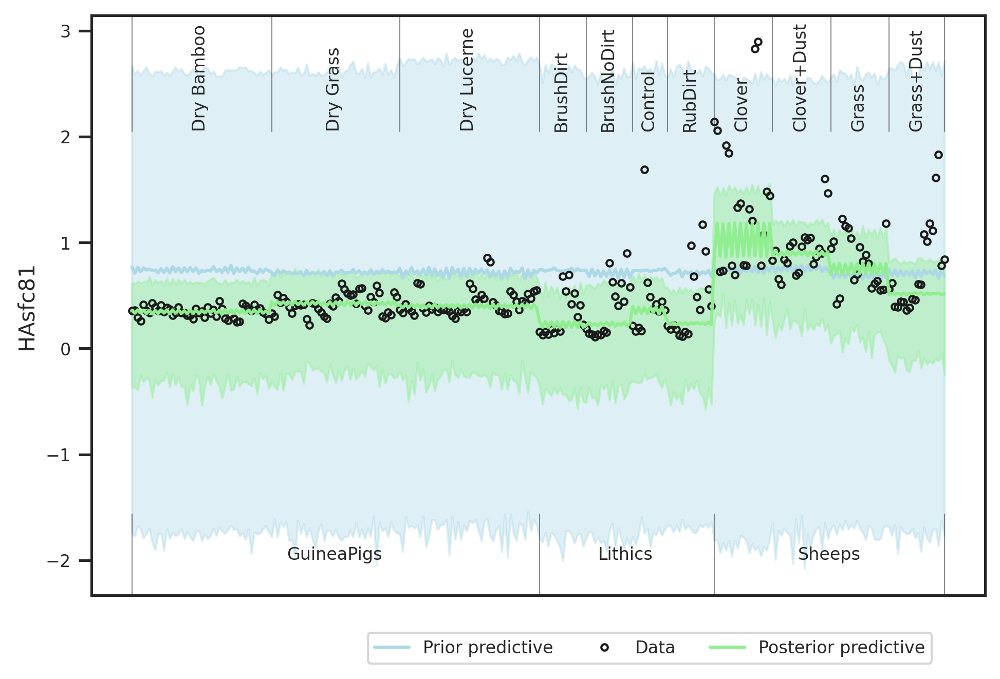

In [128]:
plotting_lib.plotPriorPosteriorPredictive(widthInch,heigthInch,dpi,writeOut,outPathPlots,df,dictMeanStd,prior_pred_HAsfc81,posterior_pred_HAsfc81,dataZ["HAsfc81_z"].values,'HAsfc81')

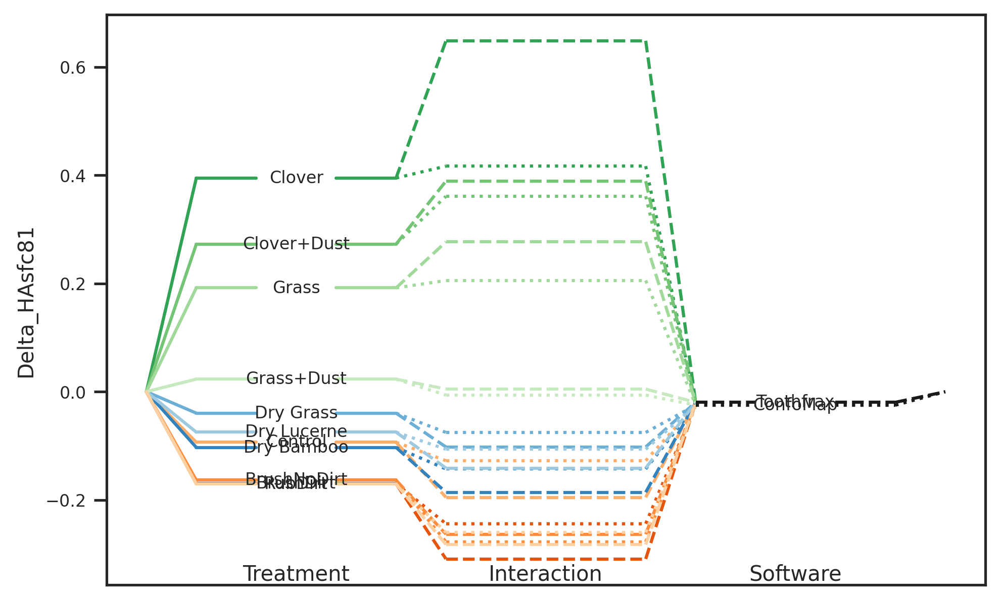

In [129]:
plotting_lib.plotLevels(widthInch,heigthInch,dpi,sizes,writeOut,outPathPlots,dictMeanStd,dictTreatment,dictSoftware,trace_HAsfc81,'HAsfc81',x1,x2)

#### Compare prior and posterior for model parameters

In [130]:
with HAsfc81Model as model:
    pm_data_HAsfc81 = az.from_pymc3(trace=trace_HAsfc81,prior=prior_pred_HAsfc81,posterior_predictive=posterior_pred_HAsfc81)

arviz.data.io_pymc3 - WARNING - posterior predictive variable HAsfc81_y's shape not compatible with number of chains and draws. This can mean that some draws or even whole chains are not represented.


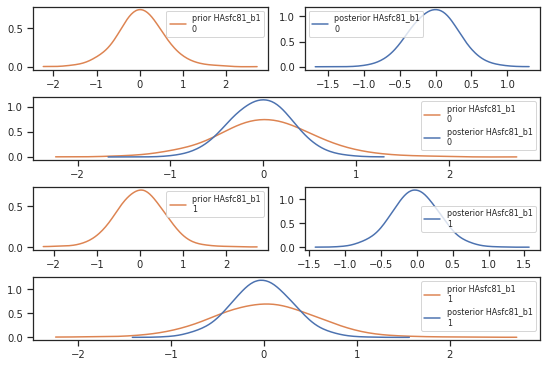

In [131]:
plotting_lib.plotPriorPosteriorB(widthInch,heigthInch,dpi,sizes,writeOut,outPathPlots,dictMeanStd,pm_data_HAsfc81,'HAsfc81')

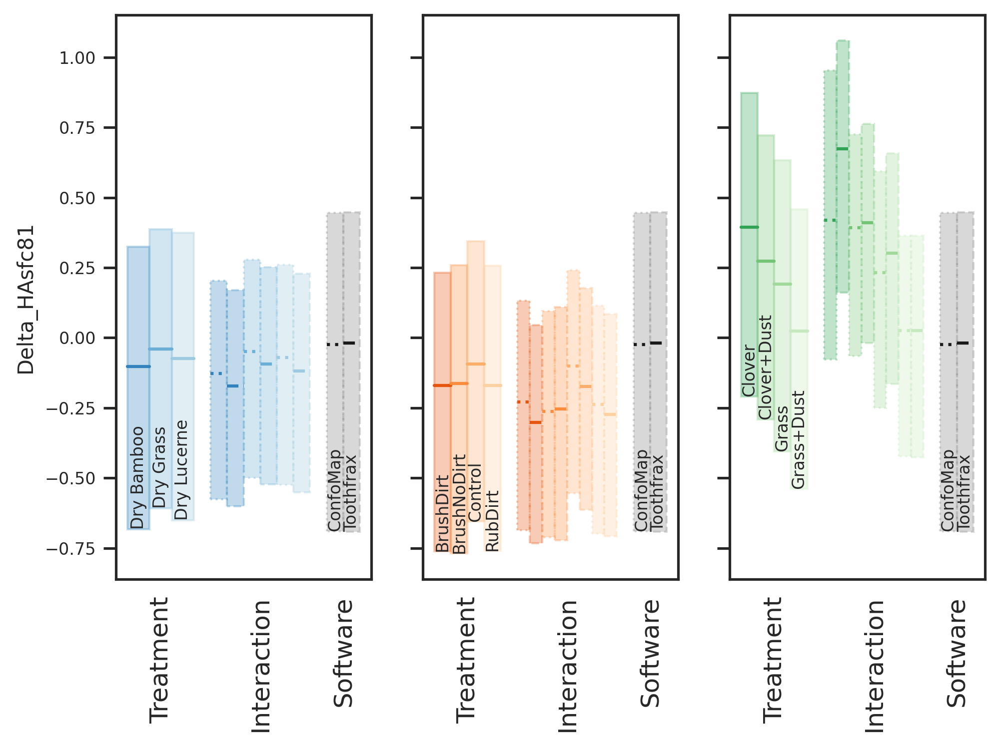

In [132]:
plotting_lib.plotLevelsStd(widthInch,heigthInch,dpi,sizes,writeOut,outPathPlots,dictMeanStd,dictTreatment,dictSoftware,trace_HAsfc81,'HAsfc81',x1,x2)

#### Posterior and contrasts

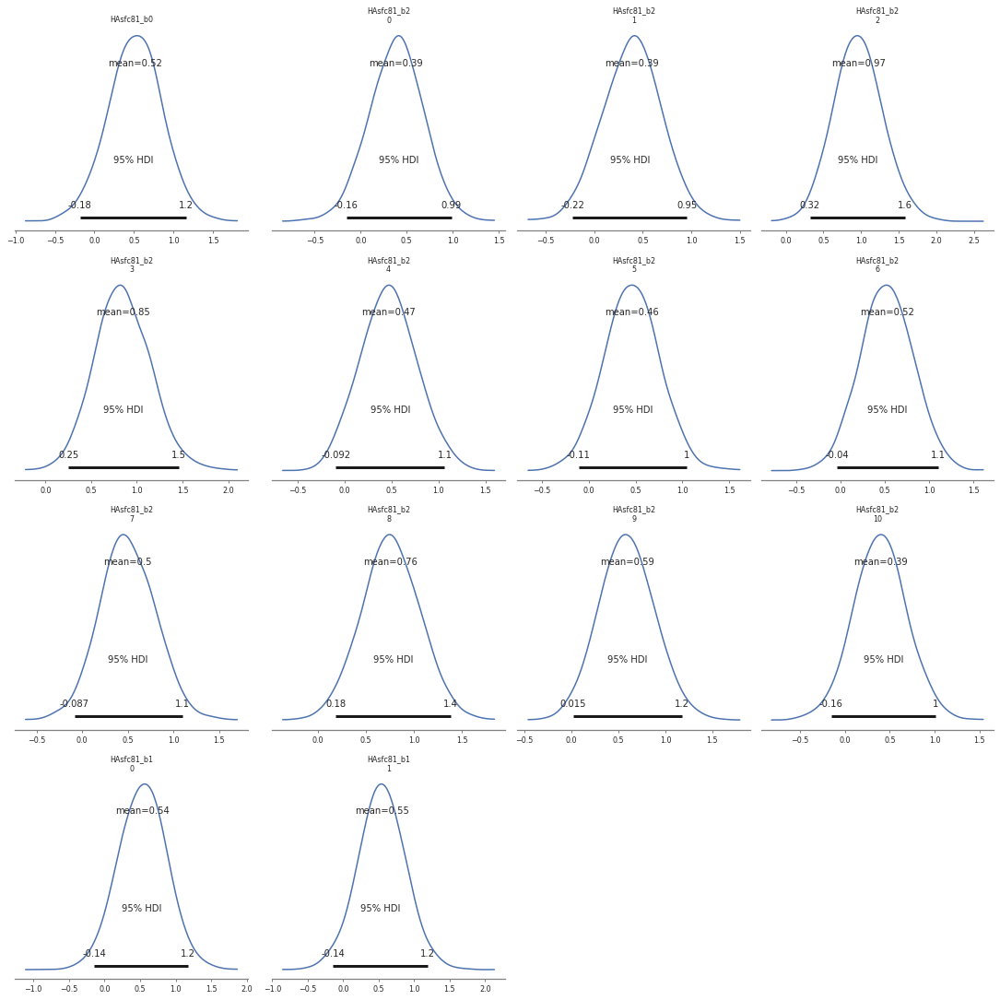

In [133]:
plotting_lib.plotPosterior(widthInch,heigthInch,dpi,writeOut,outPathPlots,dictMeanStd,pm_data_HAsfc81,'HAsfc81')

In [139]:
df_hdi_HAsfc81 = plotting_lib.plotTreatmentPosterior(widthInch,heigthInch,dpi,sizes,writeOut,outPathPlots,dictMeanStd,dictTreatment,dictSoftware,trace_HAsfc81,'HAsfc81',x1,x2)

In [140]:
df_hdi_HAsfc81

,Treatment_i,Treatment_j,hdi_ConfoMap_2.5%,hdi_ConfoMap_97.5%,isSignificant_on_ConfoMap,hdi_Toothfrax_2.5%,hdi_Toothfrax_97.5%,isSignificant_on_Toothfrax
0,Dry Grass,Dry Bamboo,0.015803,0.141280,True,0.017960,0.136534,True
1,Dry Lucerne,Dry Bamboo,-0.007991,0.109962,False,-0.002442,0.112198,False
2,Dry Lucerne,Dry Grass,-0.089879,0.046539,False,-0.082805,0.045862,False
3,BrushNoDirt,BrushDirt,-0.299553,0.301233,False,-0.141142,0.294944,False
4,Control,BrushDirt,-0.109822,0.338131,False,-0.031861,0.276561,False
5,Control,BrushNoDirt,-0.136611,0.359291,False,-0.171764,0.286131,False
6,RubDirt,BrushDirt,-0.275800,0.249341,False,-0.119907,0.203854,False
7,RubDirt,BrushNoDirt,-0.278006,0.310684,False,-0.288717,0.208890,False
8,RubDirt,Control,-0.339363,0.089056,False,-0.266739,0.090167,False
9,Clover+Dust,Clover,-0.531301,0.215196,False,-0.548465,0.102834,False


In [141]:
if writeOut:
    df_hdi_HAsfc81.to_csv(outPathData+ 'hdi_{}.csv'.format('HAsfc81'))

#### Bimodal distribution in contrast plots
For e.g. the pair Clover+Dust vs. Clover shows an unexpected bimodal distribution of the contrast.
We now examine the traces carefully to exclude errors in the sampling:  
Get the traces on ConfoMap of the interactions

In [135]:
m12_clover = trace_HAsfc81['HAsfc81_M12'][:,0,2]
m12_cloverDust = trace_HAsfc81['HAsfc81_M12'][:,0,3]
diff_m12 = m12_cloverDust-m12_clover

Get the traces of the treatments:

In [136]:
b2_clover = trace_HAsfc81['HAsfc81_b2'][:,2]
b2_cloverDust = trace_HAsfc81['HAsfc81_b2'][:,3]
diff_b2 = b2_cloverDust-b2_clover

Look at all the pairs

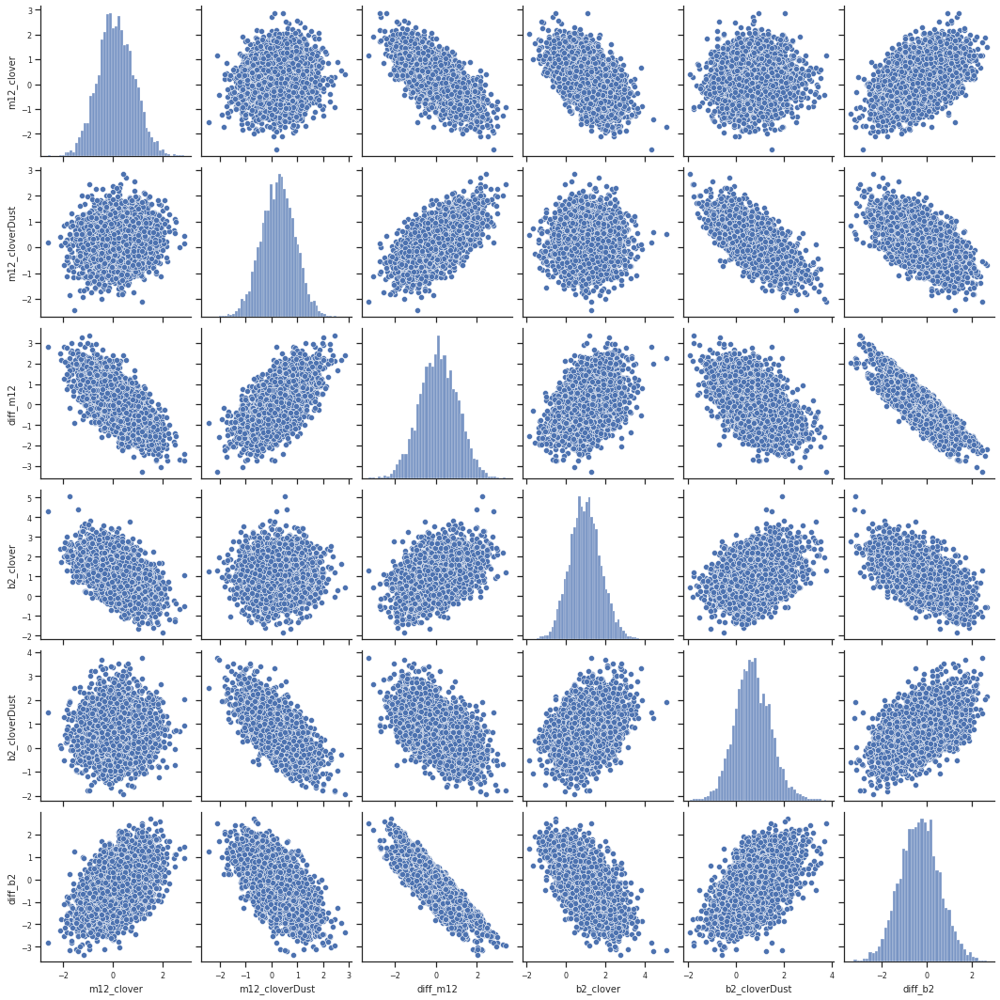

In [137]:
sns.pairplot(data=pd.DataFrame.from_dict(
    {'m12_clover':m12_clover,'m12_cloverDust':m12_cloverDust,'diff_m12':diff_m12,
     'b2_clover':b2_clover,'b2_cloverDust':b2_cloverDust,'diff_b2':diff_b2
    }
));

Let's have that of the differences again

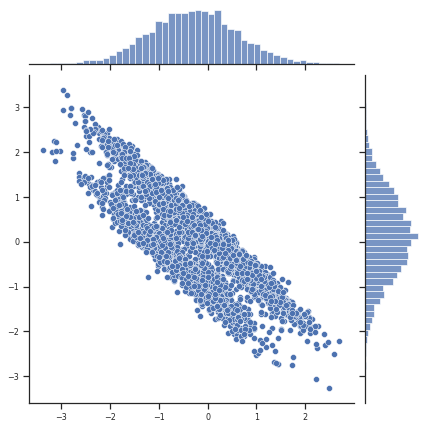

In [138]:
sns.jointplot(x=diff_b2,y=diff_m12);

We see two sets that are distributed along parallel lines in the scatter plot.
This means that the model estimates two subsets of possible differences.  
However, when looking at the raw data at 'analysis/plots/SSFA_Sheeps_plot.pdf' one can see that the distribution of values for HAsfc81 on Clover (Sheep) measured by ConfoMap appear to have a bimodal distribution.  
Thus, in combination with the chosen uninformative priors, the model correctly describes the distribution as bimodal.  
In summary, we see no issue with the modeling and sampling.

### Write out

In [151]:
!jupyter nbconvert --to html Statistical_Model_TwoFactor.ipynb

[NbConvertApp] Converting notebook Statistical_Model_TwoFactor.ipynb to html
[NbConvertApp] Writing 26856074 bytes to Statistical_Model_TwoFactor.html


In [150]:
!jupyter nbconvert --to markdown Statistical_Model_TwoFactor.ipynb

[NbConvertApp] Converting notebook Statistical_Model_TwoFactor.ipynb to markdown
[NbConvertApp] Support files will be in Statistical_Model_TwoFactor_files/
[NbConvertApp] Making directory Statistical_Model_TwoFactor_files
[NbConvertApp] Making directory Statistical_Model_TwoFactor_files
[NbConvertApp] Making directory Statistical_Model_TwoFactor_files
[NbConvertApp] Making directory Statistical_Model_TwoFactor_files
[NbConvertApp] Making directory Statistical_Model_TwoFactor_files
[NbConvertApp] Making directory Statistical_Model_TwoFactor_files
[NbConvertApp] Making directory Statistical_Model_TwoFactor_files
[NbConvertApp] Making directory Statistical_Model_TwoFactor_files
[NbConvertApp] Making directory Statistical_Model_TwoFactor_files
[NbConvertApp] Making directory Statistical_Model_TwoFactor_files
[NbConvertApp] Making directory Statistical_Model_TwoFactor_files
[NbConvertApp] Making directory Statistical_Model_TwoFactor_files
[NbConvertApp] Making directory Statistical_Model_Tw